In [ ]:
import gc
import os
import pickle
import re

import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import pandas as pd
import scipy
from bertopic import BERTopic
from datasets import load_dataset
from gensim.parsing.preprocessing import preprocess_string
from hdbscan import HDBSCAN
from mpl_toolkits.mplot3d import Axes3D
from numba import njit, prange
from scipy.linalg import fractional_matrix_power
from scipy.sparse import csr_matrix
from sentence_transformers import SentenceTransformer
from sklearn.cluster import KMeans
from sklearn.decomposition import TruncatedSVD
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder
from tqdm import tqdm
from umap import UMAP

In [ ]:
#corpus_file = "wiki_ml.csv"
corpus_file = "wiki_ml_zeroshot.csv"

df_corpus = pd.read_csv(corpus_file, index_col=0)

In [ ]:
# Create TF-IDF vectorizer
vectorizer = TfidfVectorizer(max_df=0.5, min_df=5, stop_words='english', lowercase=True)
tfidf_matrix = vectorizer.fit_transform(df_corpus["text"])
print(tfidf_matrix.shape)

(6115, 29944)


In [ ]:
# Create TF-IDF vectorizer
vectorizer = TfidfVectorizer(
    max_df=0.5, 
    min_df=5, 
    preprocessor=preprocess_string,
    tokenizer=lambda x: x
)
tfidf_matrix = vectorizer.fit_transform(df_corpus["text"])
print(tfidf_matrix.shape)

(6115, 17164)


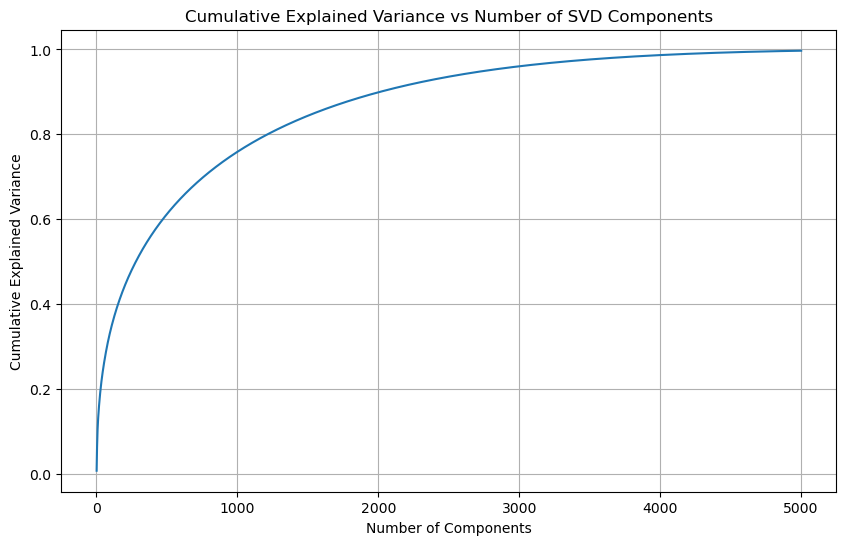

Variance explained by first 100 components: 0.3387


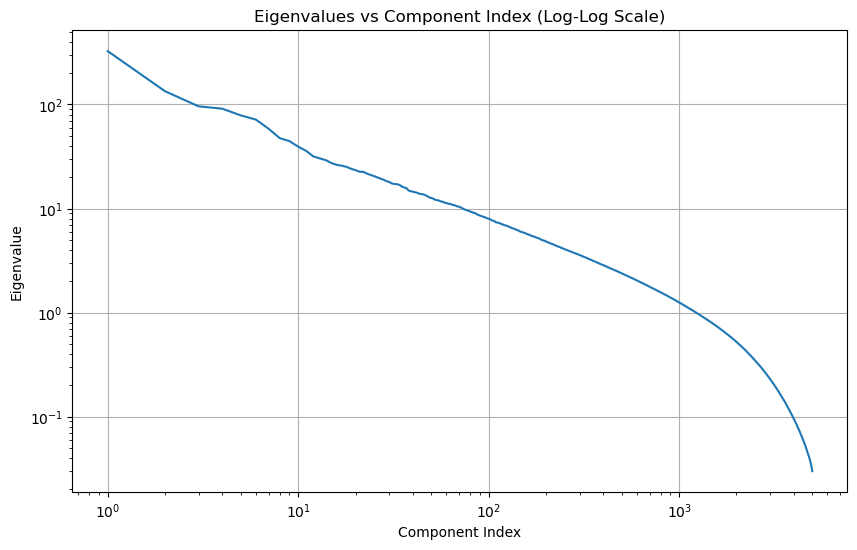

In [ ]:
# Apply SVD
n_markov_components = 5000
svd = TruncatedSVD(n_components=min(n_markov_components, tfidf_matrix.shape[1]-1), random_state=42)
svd_matrix = svd.fit_transform(tfidf_matrix)

# Calculate cumulative explained variance
cumulative_variance = np.cumsum(svd.explained_variance_ratio_)

# Plot cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs Number of SVD Components')
plt.grid(True)
plt.show()

print(f"Variance explained by first 100 components: {cumulative_variance[99]:.4f}")

# Plot eigenvalues in log-log scale
plt.figure(figsize=(10, 6))
plt.loglog(range(1, len(svd.singular_values_) + 1), svd.singular_values_**2)
plt.xlabel('Component Index')
plt.ylabel('Eigenvalue')
plt.title('Eigenvalues vs Component Index (Log-Log Scale)')
plt.grid(True)
plt.show()

In [ ]:
# Make SVD matrix non-negative by keeping the component with larger norm
svd_matrix_nonneg = np.zeros_like(svd_matrix)
epsilon = 1e-5  # Small value to avoid division by zero

for i in range(svd_matrix.shape[1]):
    column = svd_matrix[:, i]
    pos_norm = np.linalg.norm(column[column > 0])
    neg_norm = np.linalg.norm(column[column < 0])
    
    if pos_norm >= neg_norm:
        svd_matrix_nonneg[:, i] = np.maximum(column, epsilon)
    else:
        svd_matrix_nonneg[:, i] = np.maximum(-column, epsilon)

print(f"Original SVD matrix shape: {svd_matrix.shape}")
print(f"Non-negative SVD matrix shape: {svd_matrix_nonneg.shape}")
print(f"Min value in non-negative matrix: {svd_matrix_nonneg.min()}")

Original SVD matrix shape: (6115, 5000)
Non-negative SVD matrix shape: (6115, 5000)
Min value in non-negative matrix: 1e-05


Correlation(svd_entropy, text_length) = -0.046105079359345574


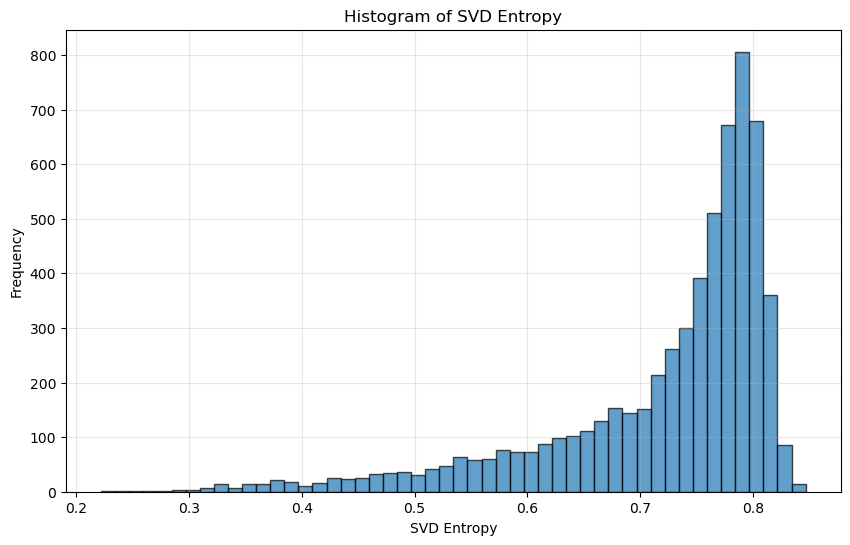

In [ ]:
# Normalize columns to sum to one
svd_matrix_normalized = svd_matrix_nonneg / np.sum(svd_matrix_nonneg, axis=0)
# TODO: try to combine both directions#
kernel_matrix = - svd_matrix_normalized @ np.log2(svd_matrix_normalized.T)

# Get diagonal values of the kernel matrix
df_corpus["svd_entropy"] = np.diag(kernel_matrix) / np.log2(kernel_matrix.shape[0])
print("Correlation(svd_entropy, text_length) =", df_corpus["svd_entropy"].corr(df_corpus["text"].map(len)))
plt.figure(figsize=(10, 6))
plt.hist(df_corpus["svd_entropy"], bins=50, alpha=0.7, edgecolor='black')
plt.xlabel('SVD Entropy')
plt.ylabel('Frequency')
plt.title('Histogram of SVD Entropy')
plt.grid(True, alpha=0.3)
plt.show()

0.0 0.2406100386382548


(array([2.4641983e+07, 5.6197300e+06, 2.0677890e+06, 1.1275670e+06,
        7.4372500e+05, 6.0766800e+05, 3.7635200e+05, 2.4931600e+05,
        2.1224400e+05, 2.2143300e+05, 1.8263700e+05, 1.3869600e+05,
        1.1933200e+05, 9.2685000e+04, 7.7729000e+04, 9.4241000e+04,
        6.4174000e+04, 4.9476000e+04, 3.8495000e+04, 2.2852000e+04,
        3.2322000e+04, 3.9246000e+04, 5.9570000e+04, 4.5858000e+04,
        4.5394000e+04, 3.8448000e+04, 2.7610000e+04, 3.6119000e+04,
        2.9403000e+04, 2.0650000e+04, 1.8966000e+04, 1.3856000e+04,
        1.5831000e+04, 1.5671000e+04, 1.8973000e+04, 2.1885000e+04,
        1.9742000e+04, 1.4583000e+04, 1.2263000e+04, 8.5550000e+03,
        9.6250000e+03, 9.6970000e+03, 8.4090000e+03, 4.9170000e+03,
        4.8330000e+03, 4.9220000e+03, 3.6240000e+03, 4.3210000e+03,
        3.9830000e+03, 2.6480000e+03, 4.1660000e+03, 5.8260000e+03,
        4.1220000e+03, 2.5070000e+03, 2.1770000e+03, 2.4020000e+03,
        1.2280000e+03, 3.9400000e+02, 5.1300000e

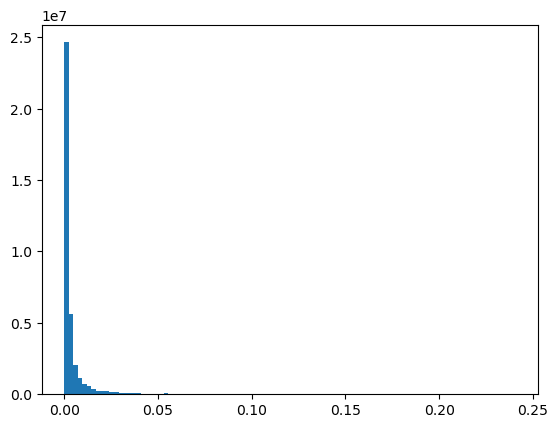

In [ ]:
sigma = 1.5  # Adjust sigma as needed for kernel smoothing
similarity_matrix = np.exp(-kernel_matrix / sigma**2)
# Set diagonal to zero to avoid self-similarity
similarity_matrix -= np.diag(np.diag(similarity_matrix))
print(similarity_matrix.min(), similarity_matrix.max())
plt.hist(similarity_matrix.flatten(), bins=100)

In [ ]:
# create diffusion matrix
markov_chain = similarity_matrix / similarity_matrix.sum(axis=0)

# compute eigendecomposition
eigenvalues, eigenvectors = np.linalg.eig(
    markov_chain.T)
eigenvalues, eigenvectors = np.real(eigenvalues), np.real(eigenvectors)
eigv_inv = scipy.linalg.pinv(eigenvectors)

# Sort eigenvalues and eigenvectors in descending order
sorted_indices = np.argsort(np.abs(eigenvalues))[::-1]
eigenvalues = eigenvalues[sorted_indices]
eigenvectors = eigenvectors[:, sorted_indices]
eigv_inv = eigv_inv[sorted_indices, :]

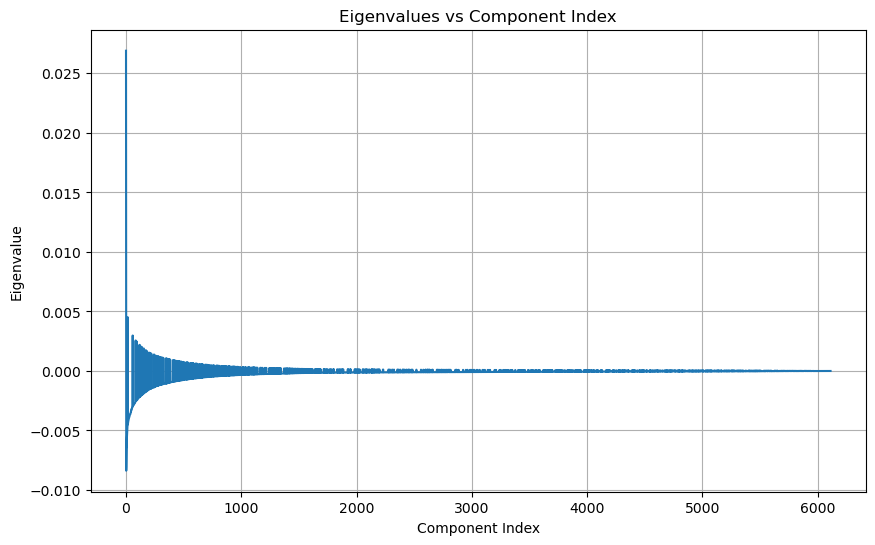

In [ ]:
# Plot eigenvalues to determine the number of components to use
plt.figure(figsize=(10, 6))
plt.plot(eigenvalues[1:])
plt.xlabel('Component Index')
plt.ylabel('Eigenvalue')
plt.title('Eigenvalues vs Component Index')
plt.grid(True)
plt.show()

In [ ]:
# Compute von Neumann entropy for multiple diffusion times t
t_values = np.linspace(1, 3, 17)
von_neumann_entropies = []

for t in tqdm(t_values):
    continue
    # Compute the diffused Markov matrix for time t
    eigv_power = np.diag(np.where(eigenvalues[:n_markov_components] > 0, eigenvalues[:n_markov_components]**t, eigenvalues[:n_markov_components]))
    M_t = eigv_inv[:n_markov_components].T @ eigv_power @ eigenvectors[:, :n_markov_components].T
    M_t = M_t @ M_t.T

    plt.imshow(M_t, cmap='viridis')
    plt.show()

    # Normalize eigenvalues to form a probability distribution
    eigenvalues_t = np.linalg.eigvalsh(M_t)
    eigenvalues_t = np.real(eigenvalues_t) + 1e-10  # Ensure eigenvalues are real
    eigenvalues_t = np.abs(eigenvalues_t) / np.sum(eigenvalues_t)

    # Compute von Neumann entropy
    entropy = -np.sum(eigenvalues_t * np.log(eigenvalues_t))
    if np.isnan(entropy) or np.isinf(entropy):
        print(f"Warning: Entropy calculation resulted in NaN or Inf for t={t}. Skipping this value.")
        continue
    von_neumann_entropies.append(entropy)
    if t == t_values[-1]:
        # Plot von Neumann entropy vs diffusion time
        plt.figure(figsize=(10, 6))
        plt.plot(t_values, von_neumann_entropies, marker='o')
        plt.semilogy()
        plt.xlabel('Diffusion Time (t)')
        plt.ylabel('Von Neumann Entropy')
        plt.title('Von Neumann Entropy vs Diffusion Time')
        plt.grid(True)
        plt.show()

100%|██████████| 17/17 [00:00<00:00, 385422.53it/s]


In [ ]:
# find points lying on the geodesic path, i.e. interpolating on the manifold
# - got to the nearest point that is still closer to the reference point than the current point?

# - build k nearest neighbors graph with small k, large enough to connect
# - find shortest path with A*

# Calculate pairwise diffusion distances using einsum


# Choose a diffusion time t 1, 1.5, 2, 2.5
# higher diffusion time will seperate high entropy points more from low entropy points,
# results in longer paths between points with low and high entropy
t = 1.25
# Compute the diffused Markov matrix for time t
#M_t = eigv_inv[:n_markov_components].T @ np.diag(eigenvalues[:n_markov_components])**t @ eigenvectors[:, :n_markov_components].T

if t % 1 != 0:
    # only raise positive eigenvalues to power t
    #eigv_power = np.diag(np.where(eigenvalues[:n_markov_components] > 0, eigenvalues[:n_markov_components]**t, eigenvalues[:n_markov_components]))
    # Use fractional matrix power for non-integer t
    #eigv_power = np.abs(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
    # use real part of fractional matrix power to avoid complex numbers
    eigv_power = np.real(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
else:
    eigv_power = np.diag(eigenvalues[:n_markov_components])**t
M_t = eigv_inv[:n_markov_components].T @ eigv_power @ eigenvectors[:, :n_markov_components].T
M_t = M_t.T
print(M_t.sum(axis=1), M_t.min(), M_t.max())

[1. 1. 1. ... 1. 1. 1.] -0.00037746207122009754 0.005297062634115174


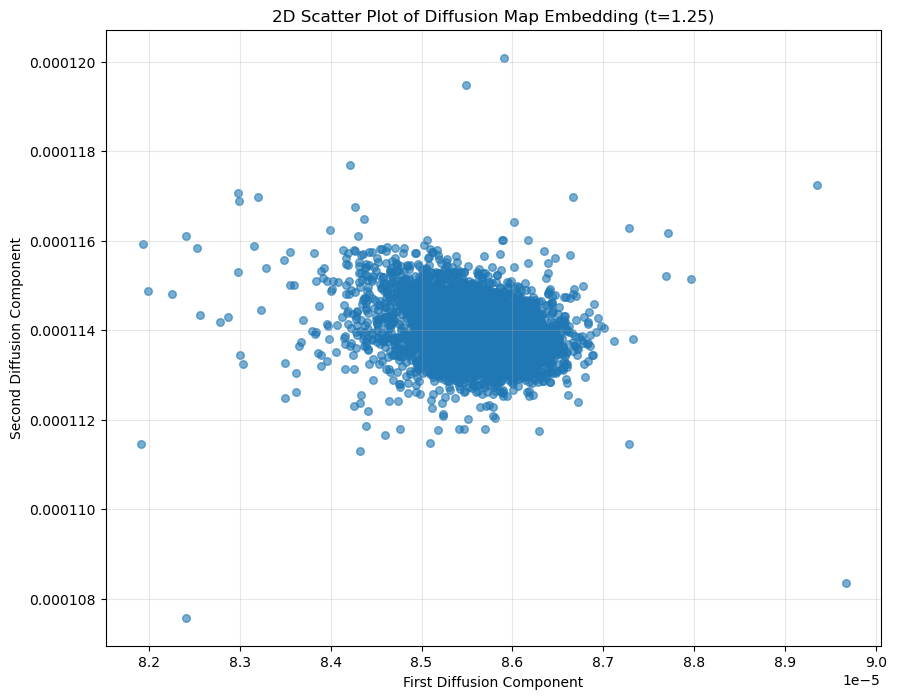

In [ ]:
x, y, z = M_t[:, 1:4][:, 0], M_t[:, 1:4][:, 1], M_t[:, 1:4][:, 2]
plt.figure(figsize=(10, 8))
plt.scatter(x, y, alpha=0.6, s=30)
plt.xlabel('First Diffusion Component')
plt.ylabel('Second Diffusion Component')
plt.title(f'2D Scatter Plot of Diffusion Map Embedding (t={t})')
plt.grid(True, alpha=0.3)
plt.show()

Sample diffusion distance: 0.005980608206358456


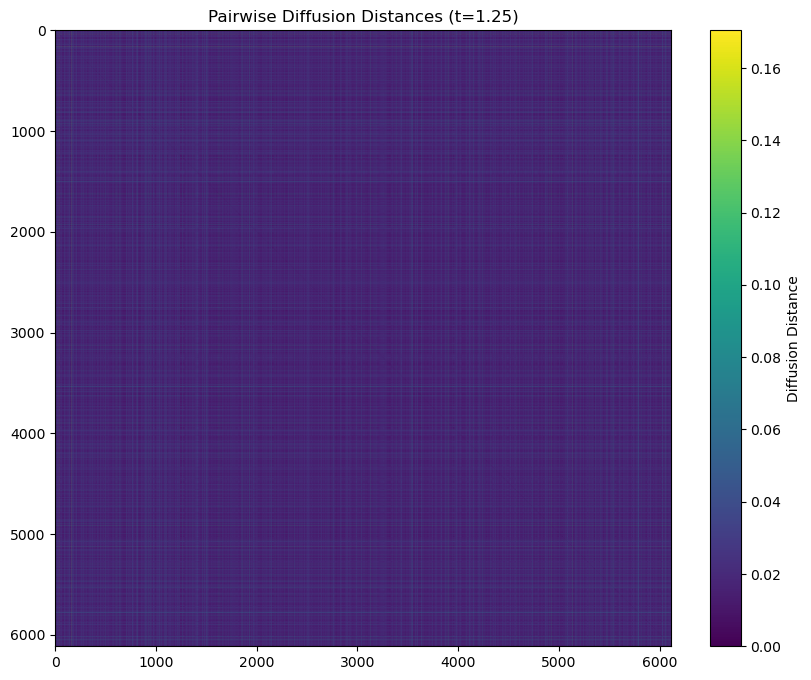

In [ ]:
@njit(parallel=True)
def compute_diffusion_distances(M_t, stationary_distribution):
    n = M_t.shape[0]
    diffusion_distances = np.zeros((n, n))
    for i in prange(n):
        for j in range(i + 1, n):
            diff = M_t[i] - M_t[j]
            distance = np.sum((diff**2) / stationary_distribution)
            diffusion_distances[i, j] = distance
            diffusion_distances[j, i] = distance  # Symmetric matrix
    return diffusion_distances

# Compute pairwise diffusion distances
diffusion_distances = compute_diffusion_distances(M_t, eigenvectors[:, 0]**2)
diffusion_distances = np.sqrt(diffusion_distances)  # Take square root to get distances

# Print a sample diffusion distance
print(f"Sample diffusion distance: {diffusion_distances[0, 1]}")

plt.figure(figsize=(10, 8))
plt.imshow(diffusion_distances, cmap='viridis')
plt.colorbar(label='Diffusion Distance')
plt.title(f'Pairwise Diffusion Distances (t={t})')
plt.show()

In [ ]:
# Create KNN graph
k = 5
n = diffusion_distances.shape[0]
knn_graph = np.zeros((n, n))

# For each point, find its k nearest neighbors
for i in range(n):
    # Get distances from point i to all other points
    distances = diffusion_distances[i]
    # Find indices of k nearest neighbors (excluding itself)
    nearest_indices = np.argsort(distances)[1:k+1]
    # Add edges to KNN graph
    knn_graph[i, nearest_indices] = distances[nearest_indices]
    knn_graph[nearest_indices, i] = distances[nearest_indices]  # Make the graph undirected

# Convert to sparse matrix for efficiency
sparse_knn_graph = csr_matrix(knn_graph)

# Create a NetworkX graph
G = nx.Graph(sparse_knn_graph)

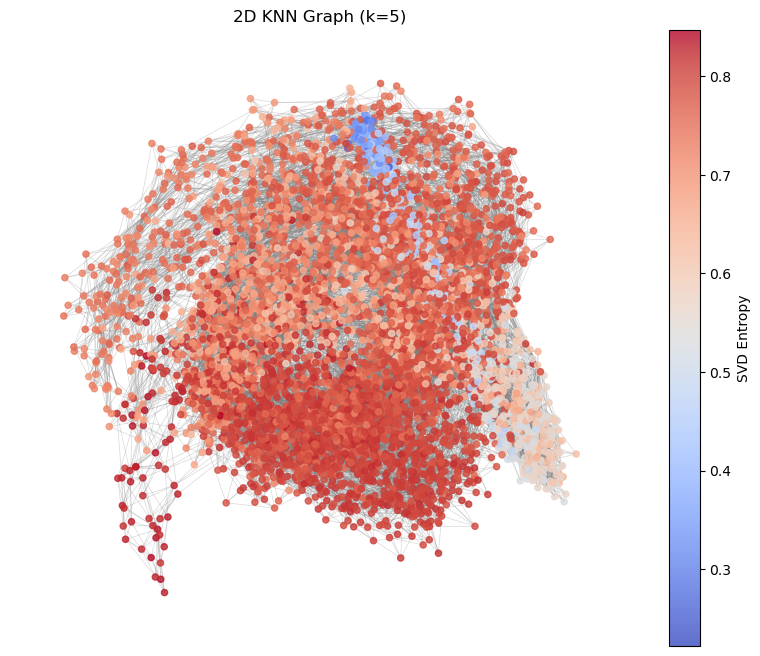

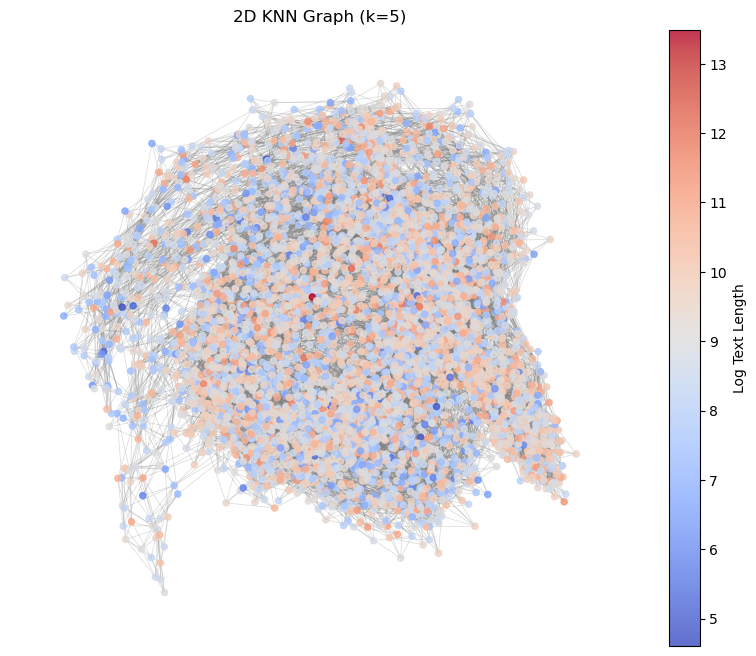

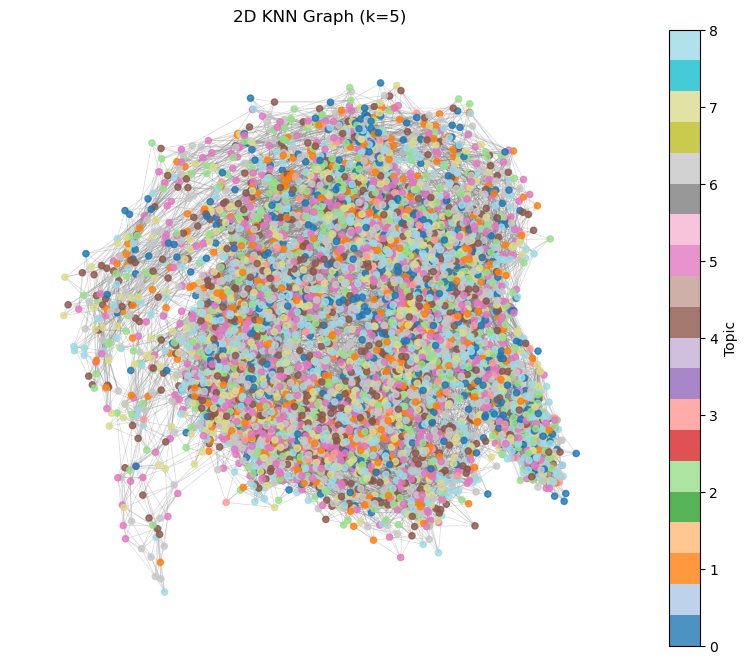

In [ ]:
# Create compact 2D spring layout visualization
pos_2d = nx.spring_layout(G, k=1, iterations=50)

# Draw edges and nodes
plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=np.log(df_corpus["text"].str.len()), 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='Log Text Length')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
le = LabelEncoder()
domain_encoded = le.fit_transform(df_corpus["topic"])
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=domain_encoded,
                                cmap='tab20',
                                alpha=0.8)
plt.colorbar(scatter, label='Topic')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

In [ ]:
df_corpus[["text", "svd_entropy"]].sample(50).sort_values(by="svd_entropy")

,text,svd_entropy
5669431,# Chapter 9 – Back Propagation#\n\nData Scienc...,0.330682
1203790,# Understanding principal component analysis\n...,0.385504
317513,# Law of total expectation\n\nThe proposition ...,0.475504
587257,"# MLP\n\nIn this post, we will go through basi...",0.501421
1465144,"# Trace (linear algebra)\n\nIn linear algebra,...",0.510007
4931974,"## Introduction\n\nMachine learning (ML)1,2,3,...",0.545480
5295044,# List of numerical analysis topics\n\nThis is...,0.552413
2143347,A Machine Learning Framework for Julia\n\n# In...,0.593275
4809988,# What are Convolutions?\n\nFor quite some tim...,0.603808
3154098,## Introduction\n\nGoing far beyond the obviou...,0.606380


Start point index: 4144, Text: Unsupervised learning

Unsupervised learning tries to understand the grouping or the latent structur...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 4144 to point 216:
[4144, 5916, 1849, 3222, 3529, 587, 5116, 5016, 862, 4882, 4814, 2191, 6102, 5294, 1285, 5612, 5908, 216]
Path length: 0.0906


,url,text,svd_entropy
4144,https://jhui.github.io/2017/01/15/Machine-lear...,Unsupervised learning\n\nUnsupervised learning...,0.840356
5916,https://nustat.github.io/intro-stat-ds/5-regre...,# Chapter 5 Basic Regression\n\nNow that we ar...,0.831904
1849,http://datascienceguide.github.io/naive-bayes-...,# Naive bayes classifier\n\nThe Bayesian appro...,0.827716
3222,https://ubc-dsci.github.io/introduction-to-dat...,# Chapter 6 Classification I: training & predi...,0.826906
3529,https://bradleyboehmke.github.io/HOML/linear-r...,# Chapter 4 Linear Regression\n\nLinear regres...,0.813014
587,https://dzlab.github.io/dl/2019/01/20/DeViSE-k...,Deep Visual-Semantic Embedding Model with Kera...,0.822149
5116,https://kharshit.github.io/blog/2019/01/04/the...,"# The gradient problem in RNN\n\nFriday, Janua...",0.777436
5016,https://www.nature.com/articles/s41598-021-042...,Thank you for visiting nature.com. You are usi...,0.801884
862,https://spellonyou.github.io/2020/04/v3-2019-l...,# Part1 lesson6 note | fastai 2019 course-v3\n...,0.810714
4882,https://homerhanumat.github.io/r-notes/vectors...,# 2 Vectors\n\nThis Chapter gets you started o...,0.796123


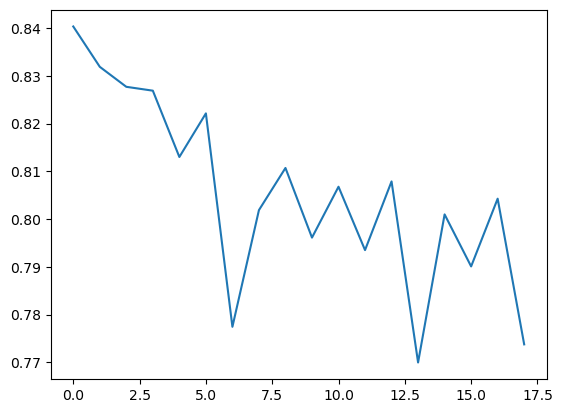

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Principal component analysis"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

In [ ]:
# find points lying on the geodesic path, i.e. interpolating on the manifold
# - got to the nearest point that is still closer to the reference point than the current point?

# - build k nearest neighbors graph with small k, large enough to connect
# - find shortest path with A*

# Calculate pairwise diffusion distances using einsum


# Choose a diffusion time t 1, 1.5, 2, 2.5
# higher diffusion time will seperate high entropy points more from low entropy points,
# results in longer paths between points with low and high entropy
t = 1.5
# Compute the diffused Markov matrix for time t
#M_t = eigv_inv[:n_markov_components].T @ np.diag(eigenvalues[:n_markov_components])**t @ eigenvectors[:, :n_markov_components].T

if t % 1 != 0:
    # only raise positive eigenvalues to power t
    #eigv_power = np.diag(np.where(eigenvalues[:n_markov_components] > 0, eigenvalues[:n_markov_components]**t, eigenvalues[:n_markov_components]))
    # Use fractional matrix power for non-integer t
    #eigv_power = np.abs(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
    # use real part of fractional matrix power to avoid complex numbers
    eigv_power = np.real(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
else:
    eigv_power = np.diag(eigenvalues[:n_markov_components])**t
M_t = eigv_inv[:n_markov_components].T @ eigv_power @ eigenvectors[:, :n_markov_components].T
M_t = M_t.T
print(M_t.sum(axis=1), M_t.min(), M_t.max())

[1. 1. 1. ... 1. 1. 1.] -0.000366037036036035 0.005007494963330923


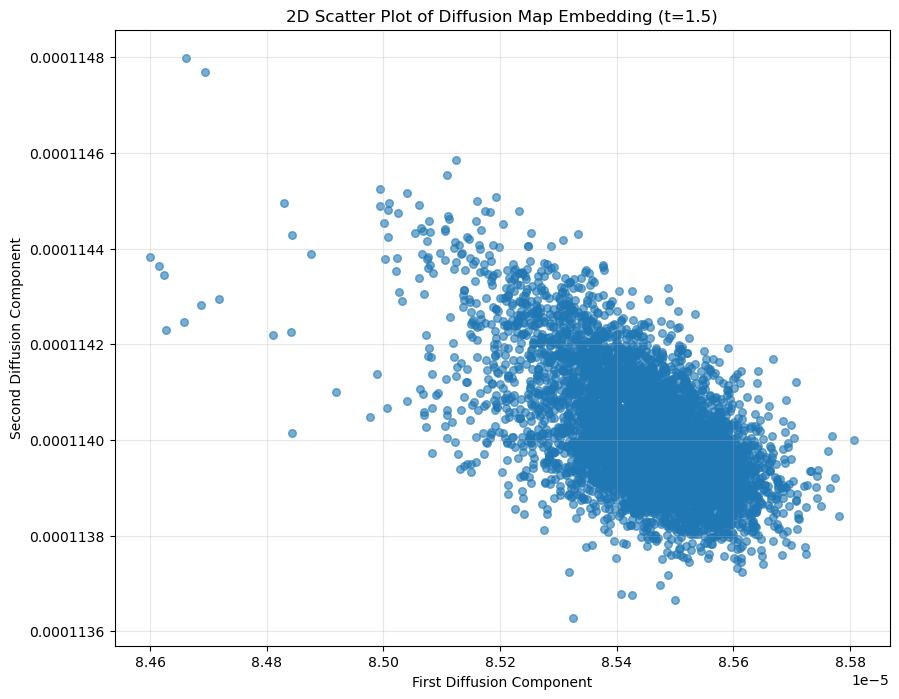

In [ ]:
x, y, z = M_t[:, 1:4][:, 0], M_t[:, 1:4][:, 1], M_t[:, 1:4][:, 2]
plt.figure(figsize=(10, 8))
plt.scatter(x, y, alpha=0.6, s=30)
plt.xlabel('First Diffusion Component')
plt.ylabel('Second Diffusion Component')
plt.title(f'2D Scatter Plot of Diffusion Map Embedding (t={t})')
plt.grid(True, alpha=0.3)
plt.show()

Sample diffusion distance: 0.0010333832272551957


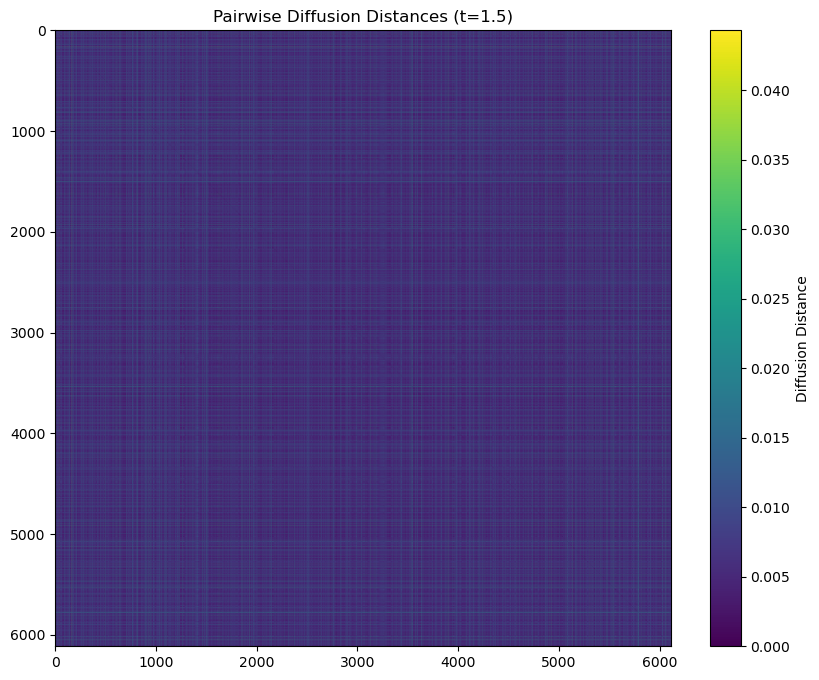

In [ ]:
@njit(parallel=True)
def compute_diffusion_distances(M_t, stationary_distribution):
    n = M_t.shape[0]
    diffusion_distances = np.zeros((n, n))
    for i in prange(n):
        for j in range(i + 1, n):
            diff = M_t[i] - M_t[j]
            distance = np.sum((diff**2) / stationary_distribution)
            diffusion_distances[i, j] = distance
            diffusion_distances[j, i] = distance  # Symmetric matrix
    return diffusion_distances

# Compute pairwise diffusion distances
diffusion_distances = compute_diffusion_distances(M_t, eigenvectors[:, 0]**2)
diffusion_distances = np.sqrt(diffusion_distances)  # Take square root to get distances

# Print a sample diffusion distance
print(f"Sample diffusion distance: {diffusion_distances[0, 1]}")

plt.figure(figsize=(10, 8))
plt.imshow(diffusion_distances, cmap='viridis')
plt.colorbar(label='Diffusion Distance')
plt.title(f'Pairwise Diffusion Distances (t={t})')
plt.show()

In [ ]:
# Create KNN graph
k = 5
n = diffusion_distances.shape[0]
knn_graph = np.zeros((n, n))

# For each point, find its k nearest neighbors
for i in range(n):
    # Get distances from point i to all other points
    distances = diffusion_distances[i]
    # Find indices of k nearest neighbors (excluding itself)
    nearest_indices = np.argsort(distances)[1:k+1]
    # Add edges to KNN graph
    knn_graph[i, nearest_indices] = distances[nearest_indices]
    knn_graph[nearest_indices, i] = distances[nearest_indices]  # Make the graph undirected

# Convert to sparse matrix for efficiency
sparse_knn_graph = csr_matrix(knn_graph)

# Create a NetworkX graph
G = nx.Graph(sparse_knn_graph)

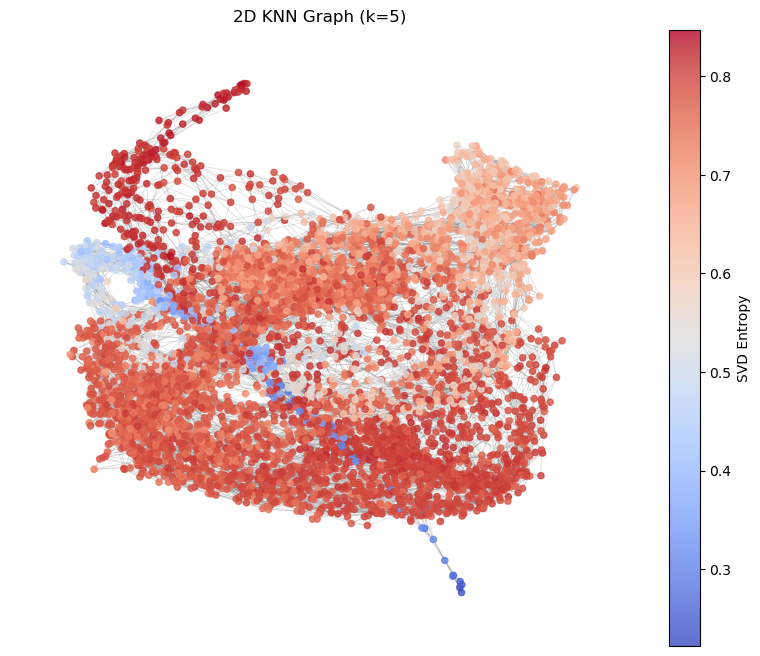

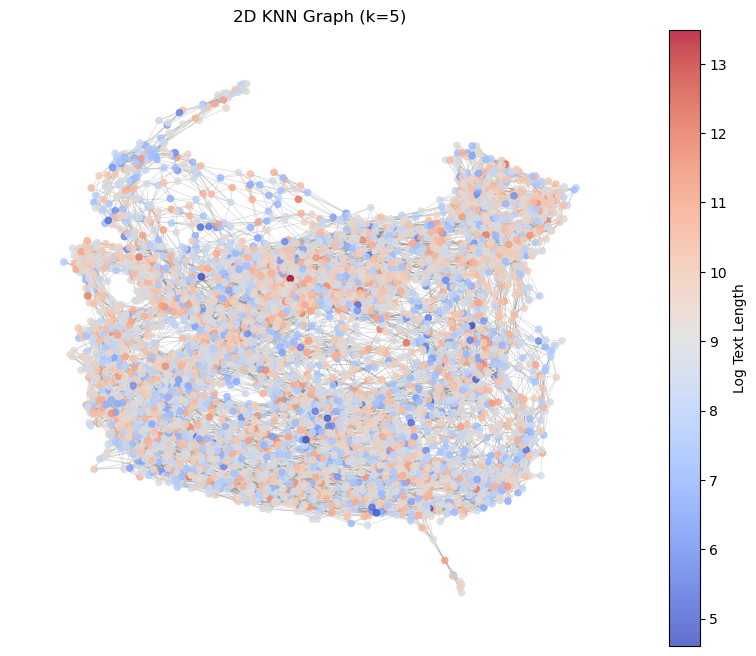

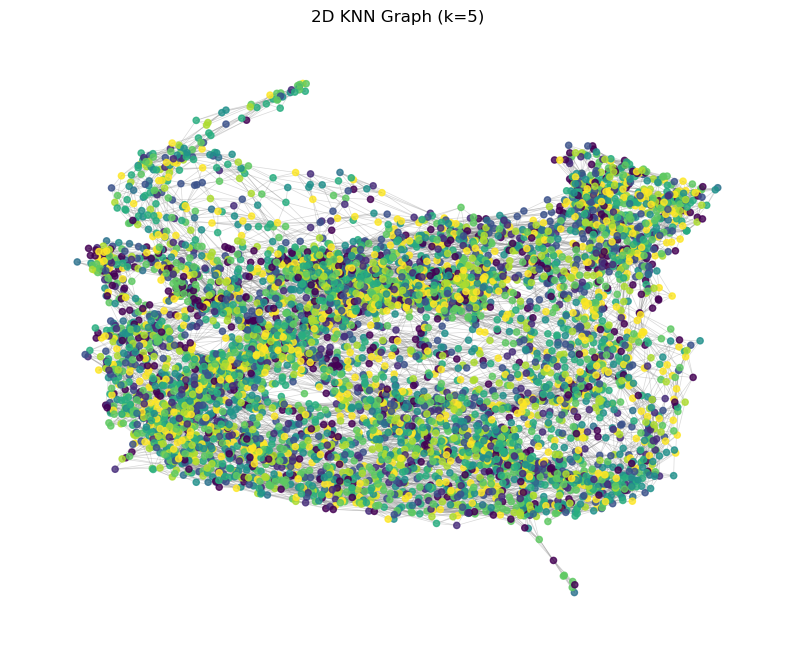

In [ ]:
# Create compact 2D spring layout visualization
pos_2d = nx.spring_layout(G, k=1, iterations=50)

# Draw edges and nodes
plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=np.log(df_corpus["text"].str.len()), 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='Log Text Length')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["topic"],
                                alpha=0.8)
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

In [ ]:
df_corpus[["text", "svd_entropy"]].sample(50).sort_values(by="svd_entropy")

,text,svd_entropy
3976,# Regression quattro stagioni\n\nLinear regres...,0.353042
5100,# scaling-up-brl/scaling-up-brl.github.io\n\nS...,0.581024
1773,## Lesson Outcomes\n\nBy the end of this lesso...,0.619547
482,This lesson is still being designed and assemb...,0.625203
5113,# Introduction\n\nUsing the pretext of numerou...,0.660008
1124,"# Linearity\n\n(Redirected from Linear)\n""Line...",0.662696
5446,## Introduction to Probability Models\n\nLectu...,0.693412
3226,# Lecture 16: Building Blocks of Deep Learning...,0.697064
2674,# Philosophy of statistics\n\nStatistics are w...,0.697391
5277,"In recent years, deep neural networks (DNNs) h...",0.699297


Start point index: 4144, Text: Unsupervised learning

Unsupervised learning tries to understand the grouping or the latent structur...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 4144 to point 216:
[4144, 1609, 2587, 1849, 647, 5895, 1548, 3512, 4247, 5445, 4661, 646, 3980, 2153, 411, 5702, 1793, 5175, 3983, 2726, 1700, 3787, 4707, 3511, 5220, 1744, 1569, 1021, 3856, 5667, 2797, 4334, 216]
Path length: 0.0210


,url,text,svd_entropy
4144,https://jhui.github.io/2017/01/15/Machine-lear...,Unsupervised learning\n\nUnsupervised learning...,0.840356
1609,https://sd18fall.github.io/toolboxes/machine-l...,# Machine Learning\n\n## Introduction\n\nFor t...,0.836468
2587,https://www.nature.com/articles/s41598-020-627...,Thank you for visiting nature.com. You are usi...,0.826099
1849,http://datascienceguide.github.io/naive-bayes-...,# Naive bayes classifier\n\nThe Bayesian appro...,0.827716
647,https://clear-nus.github.io/blog,"CLeAR\n\nBlog\n\nWelcome to our blog! Below, y...",0.828456
5895,https://helicqin.github.io/2018/03/15/Advanced...,# Advanced Architectures and Memory Networks\n...,0.819277
1548,https://bait509-ubc.github.io/BAIT509/things_t...,# What: Learning Outcomes¶\n\n## Course Object...,0.808556
3512,https://albertometelli.github.io/publication/0...,# Configurable Environments in Reinforcement L...,0.829986
4247,https://wenchao-ma.github.io/GDINA/reference/i...,"Calculate item fit statistics (Chen, de la Tor...",0.840208
5445,https://h2r.github.io/pomdp-py/html/api/pomdp_...,# pomdp_py.algorithms package¶\n\nExisting POM...,0.803079


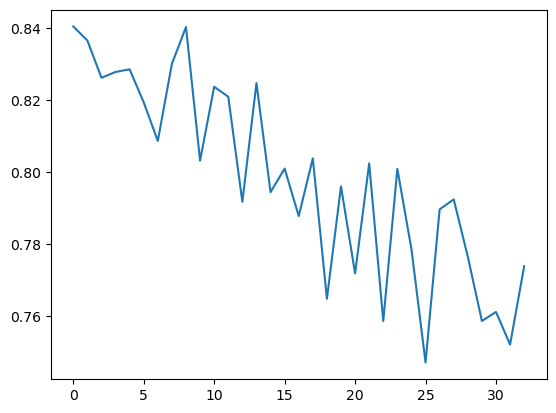

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Principal component analysis"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

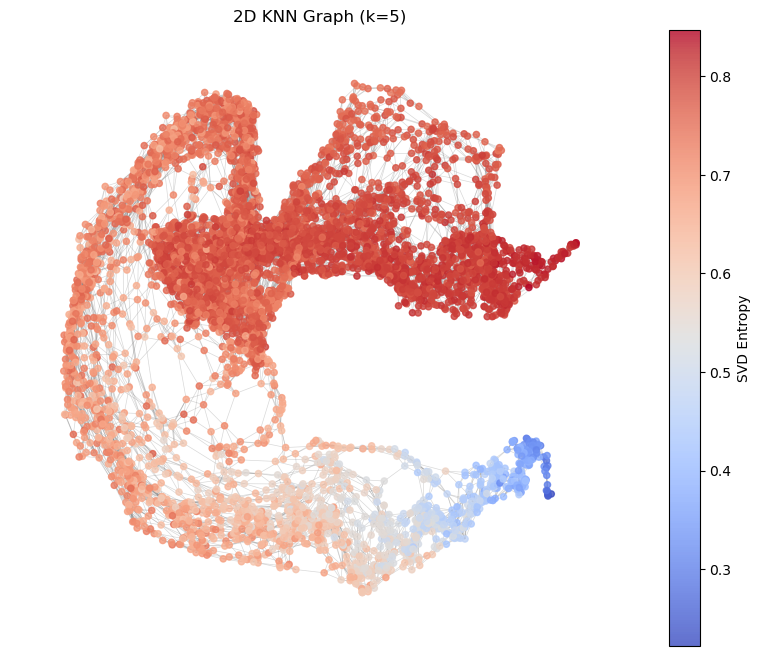

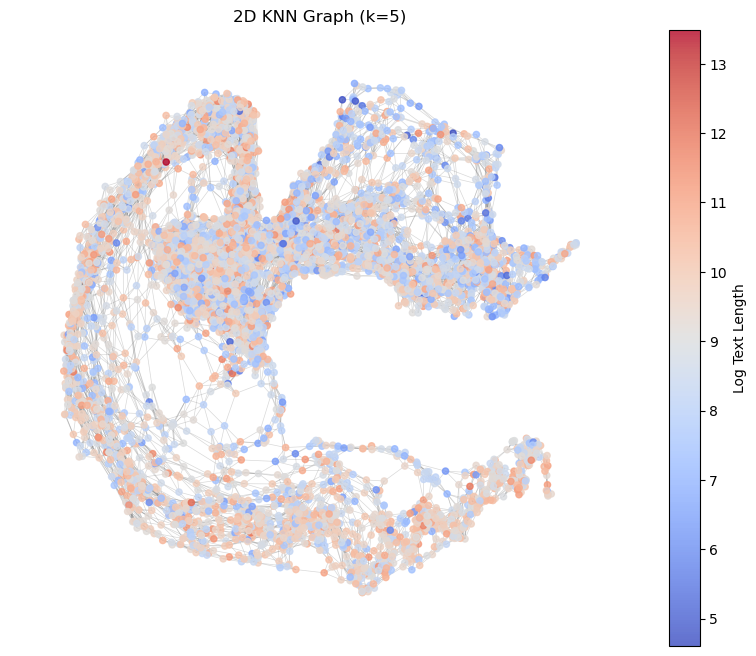

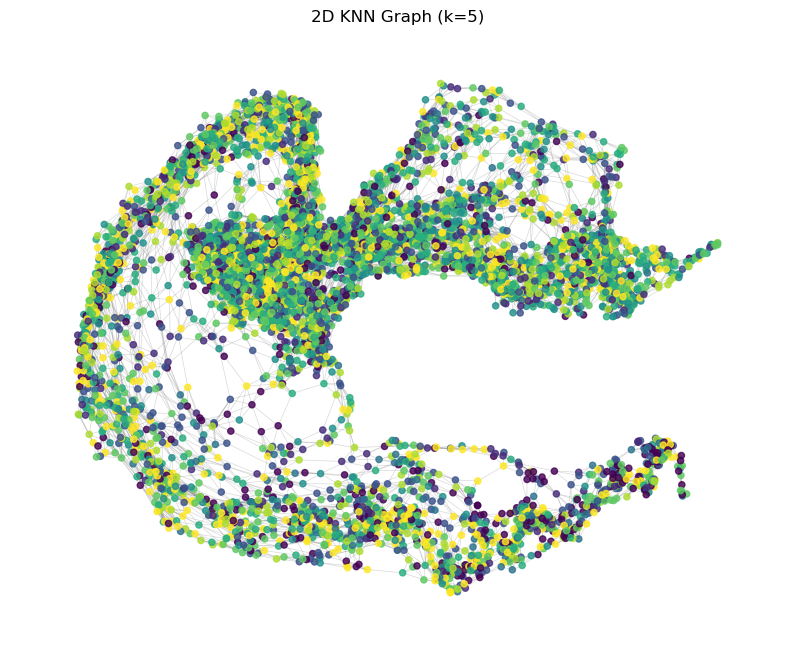

In [ ]:
# Create compact 2D spring layout visualization
pos_2d = nx.spring_layout(G, iterations=50, seed=42)

# Draw edges and nodes
plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=np.log(df_corpus["text"].str.len()), 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='Log Text Length')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["topic"],
                                alpha=0.8)
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

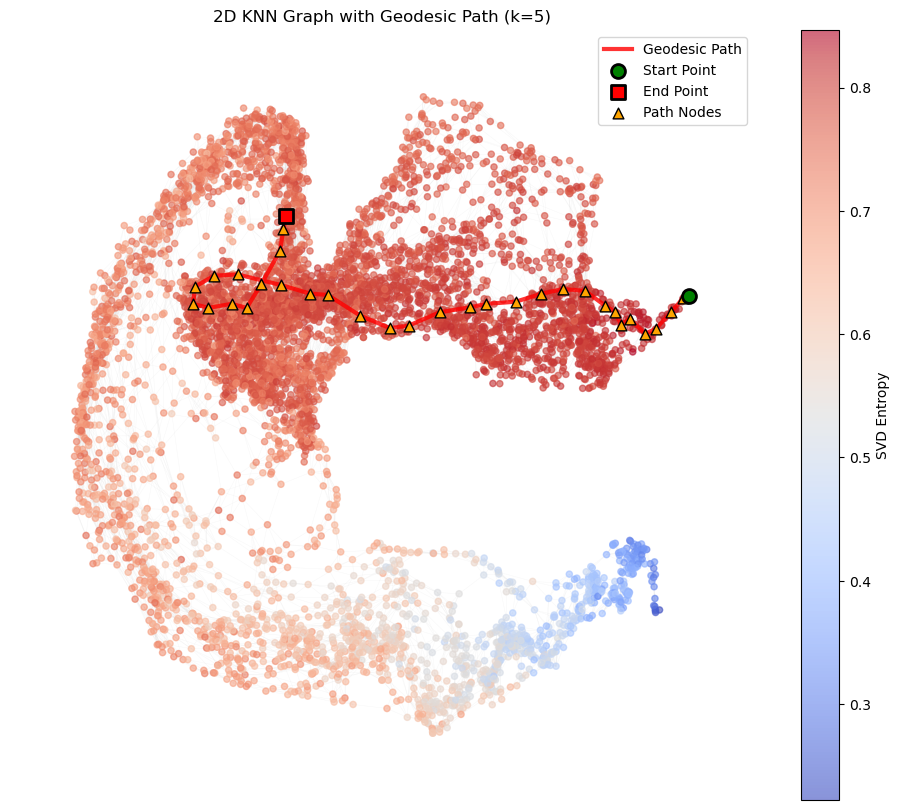

In [ ]:
# Plot the spring layout with the geodesic path highlighted
plt.figure(figsize=(12, 10))

# Draw all edges in light gray
nx.draw_networkx_edges(G, pos_2d, alpha=0.2, width=0.3, edge_color='lightgray')

# Draw all nodes colored by SVD entropy
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.6)

# Highlight the path nodes in larger size
if 'path' in locals():
    path_nodes = [pos_2d[node] for node in path]
    path_x = [pos[0] for pos in path_nodes]
    path_y = [pos[1] for pos in path_nodes]
    
    # Draw path as connected line
    plt.plot(path_x, path_y, 'r-', linewidth=3, alpha=0.8, label='Geodesic Path')
    
    # Highlight start and end points
    plt.scatter([path_x[0]], [path_y[0]], s=100, c='green', marker='o', 
               label='Start Point', edgecolors='black', linewidth=2, zorder=5)
    plt.scatter([path_x[-1]], [path_y[-1]], s=100, c='red', marker='s', 
               label='End Point', edgecolors='black', linewidth=2, zorder=5)
    
    # Highlight intermediate path nodes
    if len(path_x) > 2:
        plt.scatter(path_x[1:-1], path_y[1:-1], s=60, c='orange', marker='^', 
                   label='Path Nodes', edgecolors='black', linewidth=1, zorder=4)

plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph with Geodesic Path (k={k})')
plt.legend()
plt.axis('off')
plt.show()

In [ ]:
df_corpus[["text", "svd_entropy"]].sample(50).sort_values(by="svd_entropy")

,text,svd_entropy
1520,"# Introducing matrices\n\nPublished:\n\nHere, ...",0.486147
4696,# The Mathematical Structure of DNN Hessians\n...,0.534549
2336,"# Laplace expansion\n\nIn linear algebra, the ...",0.547241
5501,"# Concept¶\n\n\nDiscriminative classifiers, as...",0.547294
5646,# Backpropagation\n\nConcepts\n\nsupervised le...,0.570388
3766,# Random forest\n\n(Redirected from Random for...,0.581498
2701,# Linear independence\n\nProperty of subsets o...,0.590224
5935,# A Neural Algorithm of Artistic Style\n\nIn t...,0.596577
283,"March 19, 2019\n\n# Bases and Dimension of Vec...",0.625637
1208,Photo by\n\n### one sample:\n\n$x_i \to [y_i^0...,0.659963


In [ ]:
search_term = "Introducing matrices"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

Start point index: 1520, Text: # Introducing matrices

Published:

Here, I will introduce the three main ways of thinking about mat...


Start point index: 1520, Text: # Introducing matrices

Published:

Here, I will introduce the three main ways of thinking about mat...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 1520 to point 216:
[1520, 768, 2712, 2234, 3975, 2759, 4243, 5477, 481, 1011, 4347, 521, 2840, 3301, 981, 3218, 1496, 4025, 4450, 2369, 266, 4432, 148, 5232, 4648, 1327, 882, 3685, 960, 2409, 4575, 3409, 3885, 2440, 216]
Path length: 0.0280


,url,text,svd_entropy
1520,https://mbernste.github.io/posts/matrices/,"# Introducing matrices\n\nPublished:\n\nHere, ...",0.486147
768,https://dfdazac.github.io/06-neural-networks-n...,# Neural networks from scratch with NumPy\n\nN...,0.495754
2712,https://senarvi.github.io/notes/reinforcement-...,# Decision Theory and Reinforcement Learning\n...,0.489749
2234,https://sailinglab.github.io/pgm-spring-2019/n...,# Lecture 5: Parameter Estimation in Fully Obs...,0.484450
3975,https://primer-computational-mathematics.githu...,# Basic definitions and operations#\n\nMathema...,0.524486
2759,https://en.wikipedia.org/wiki/Residual_neural_...,# Residual neural network\n\nCanonical form of...,0.572474
4243,https://leimao.github.io/blog/Generative-Adver...,"### Lei Mao\n\nMachine Learning, Artificial In...",0.612261
5477,https://smac-group.github.io/ds/section-functi...,Chapter 6 Functions\n\nThis chapter aims at hi...,0.676072
481,https://en.m.wikipedia.org/wiki/Poisson_limit_...,# Poisson limit theorem\n\nIn probability theo...,0.683145
1011,https://graviraja.github.io/transformer/,# Transformer Explained - Part 1\n\nIn this po...,0.619807


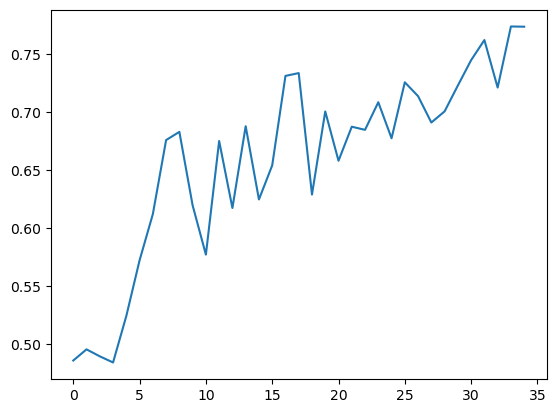

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Introducing matrices"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

Start point index: 1520, Text: # Introducing matrices

Published:

Here, I will introduce the three main ways of thinking about mat...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 1520 to point 216:
[1520, 768, 2712, 2234, 3975, 2759, 4243, 5477, 481, 1011, 4347, 521, 2840, 3301, 981, 3218, 1496, 4025, 4450, 2369, 266, 4432, 148, 5232, 4648, 1327, 882, 3685, 960, 2409, 4575, 3409, 3885, 2440, 216]
Path length: 0.0280


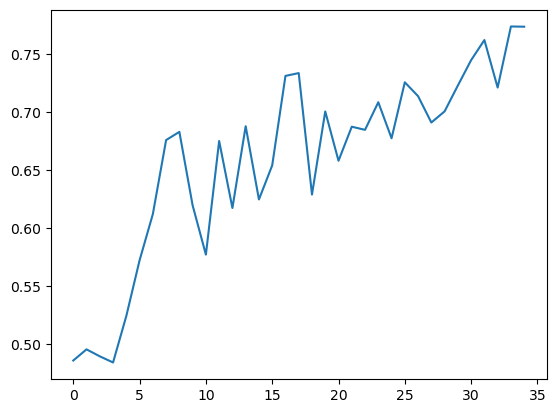

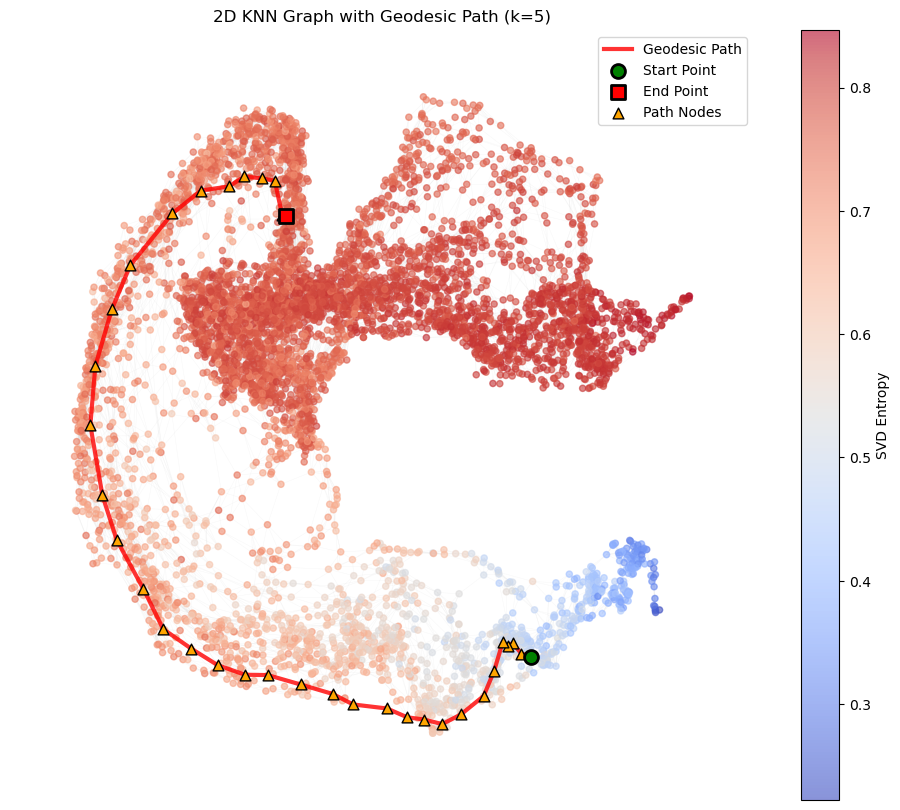

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Introducing matrices"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

# Plot the spring layout with the geodesic path highlighted
plt.figure(figsize=(12, 10))

# Draw all edges in light gray
nx.draw_networkx_edges(G, pos_2d, alpha=0.2, width=0.3, edge_color='lightgray')

# Draw all nodes colored by SVD entropy
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.6)

# Highlight the path nodes in larger size
if 'path' in locals():
    path_nodes = [pos_2d[node] for node in path]
    path_x = [pos[0] for pos in path_nodes]
    path_y = [pos[1] for pos in path_nodes]
    
    # Draw path as connected line
    plt.plot(path_x, path_y, 'r-', linewidth=3, alpha=0.8, label='Geodesic Path')
    
    # Highlight start and end points
    plt.scatter([path_x[0]], [path_y[0]], s=100, c='green', marker='o', 
               label='Start Point', edgecolors='black', linewidth=2, zorder=5)
    plt.scatter([path_x[-1]], [path_y[-1]], s=100, c='red', marker='s', 
               label='End Point', edgecolors='black', linewidth=2, zorder=5)
    
    # Highlight intermediate path nodes
    if len(path_x) > 2:
        plt.scatter(path_x[1:-1], path_y[1:-1], s=60, c='orange', marker='^', 
                   label='Path Nodes', edgecolors='black', linewidth=1, zorder=4)

plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph with Geodesic Path (k={k})')
plt.legend()
plt.axis('off')
plt.show()

Start point index: 1520, Text: # Introducing matrices

Published:

Here, I will introduce the three main ways of thinking about mat...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 1520 to point 216:
[1520, 768, 2712, 2234, 3975, 2759, 4243, 5477, 481, 1011, 4347, 521, 2840, 3301, 981, 3218, 1496, 4025, 4450, 2369, 266, 4432, 148, 5232, 4648, 1327, 882, 3685, 960, 2409, 4575, 3409, 3885, 2440, 216]
Path length: 0.0280


,url,text,svd_entropy
1520,https://mbernste.github.io/posts/matrices/,"# Introducing matrices\n\nPublished:\n\nHere, ...",0.486147
768,https://dfdazac.github.io/06-neural-networks-n...,# Neural networks from scratch with NumPy\n\nN...,0.495754
2712,https://senarvi.github.io/notes/reinforcement-...,# Decision Theory and Reinforcement Learning\n...,0.489749
2234,https://sailinglab.github.io/pgm-spring-2019/n...,# Lecture 5: Parameter Estimation in Fully Obs...,0.484450
3975,https://primer-computational-mathematics.githu...,# Basic definitions and operations#\n\nMathema...,0.524486
2759,https://en.wikipedia.org/wiki/Residual_neural_...,# Residual neural network\n\nCanonical form of...,0.572474
4243,https://leimao.github.io/blog/Generative-Adver...,"### Lei Mao\n\nMachine Learning, Artificial In...",0.612261
5477,https://smac-group.github.io/ds/section-functi...,Chapter 6 Functions\n\nThis chapter aims at hi...,0.676072
481,https://en.m.wikipedia.org/wiki/Poisson_limit_...,# Poisson limit theorem\n\nIn probability theo...,0.683145
1011,https://graviraja.github.io/transformer/,# Transformer Explained - Part 1\n\nIn this po...,0.619807


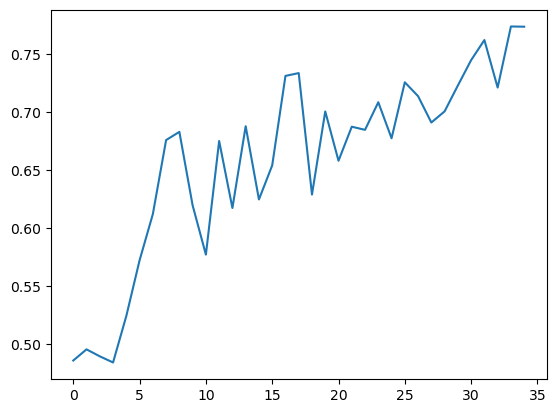

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Introducing matrices"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

In [ ]:
# find points lying on the geodesic path, i.e. interpolating on the manifold
# - got to the nearest point that is still closer to the reference point than the current point?

# - build k nearest neighbors graph with small k, large enough to connect
# - find shortest path with A*

# Calculate pairwise diffusion distances using einsum


# Choose a diffusion time t 1, 1.5, 2, 2.5
# higher diffusion time will seperate high entropy points more from low entropy points,
# results in longer paths between points with low and high entropy
t = 1.4
# Compute the diffused Markov matrix for time t
#M_t = eigv_inv[:n_markov_components].T @ np.diag(eigenvalues[:n_markov_components])**t @ eigenvectors[:, :n_markov_components].T

if t % 1 != 0:
    # only raise positive eigenvalues to power t
    #eigv_power = np.diag(np.where(eigenvalues[:n_markov_components] > 0, eigenvalues[:n_markov_components]**t, eigenvalues[:n_markov_components]))
    # Use fractional matrix power for non-integer t
    #eigv_power = np.abs(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
    # use real part of fractional matrix power to avoid complex numbers
    eigv_power = np.real(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
else:
    eigv_power = np.diag(eigenvalues[:n_markov_components])**t
M_t = eigv_inv[:n_markov_components].T @ eigv_power @ eigenvectors[:, :n_markov_components].T
M_t = M_t.T
print(M_t.sum(axis=1), M_t.min(), M_t.max())

[1. 1. 1. ... 1. 1. 1.] -0.0003684678292579262 0.005059118653882221


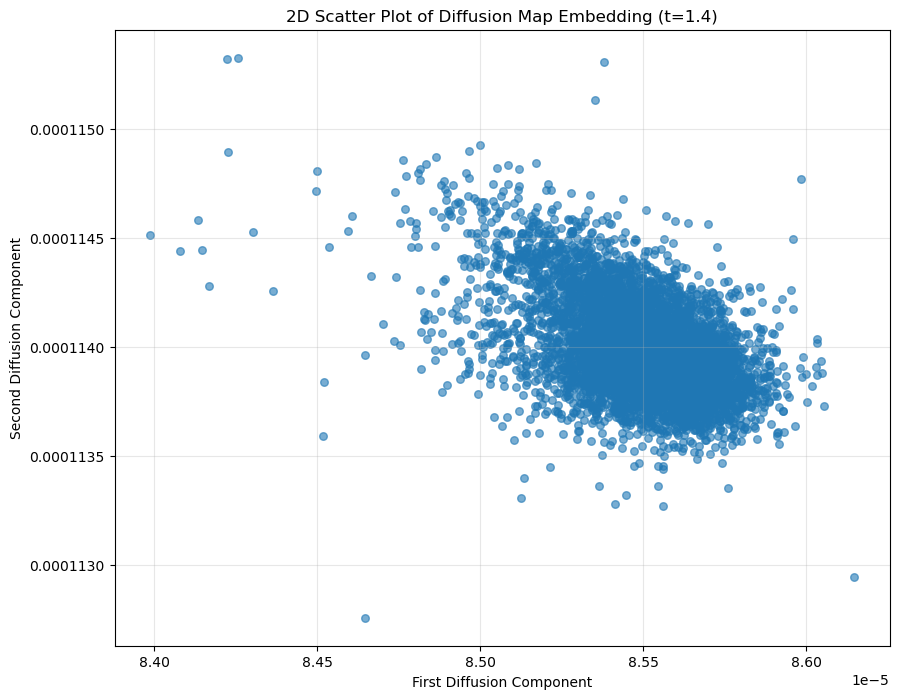

In [ ]:
x, y, z = M_t[:, 1:4][:, 0], M_t[:, 1:4][:, 1], M_t[:, 1:4][:, 2]
plt.figure(figsize=(10, 8))
plt.scatter(x, y, alpha=0.6, s=30)
plt.xlabel('First Diffusion Component')
plt.ylabel('Second Diffusion Component')
plt.title(f'2D Scatter Plot of Diffusion Map Embedding (t={t})')
plt.grid(True, alpha=0.3)
plt.show()

Sample diffusion distance: 0.0018839675778504453


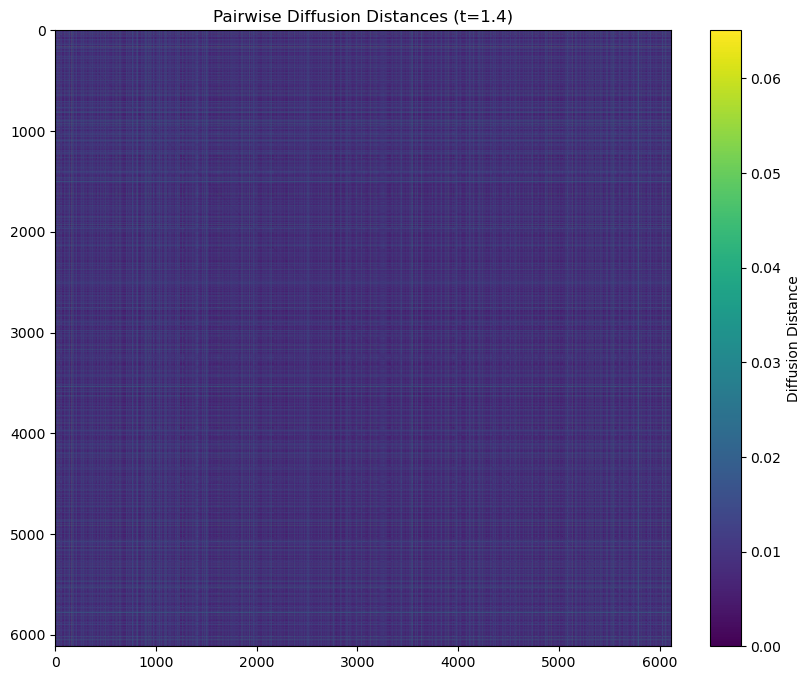

In [ ]:
@njit(parallel=True)
def compute_diffusion_distances(M_t, stationary_distribution):
    n = M_t.shape[0]
    diffusion_distances = np.zeros((n, n))
    for i in prange(n):
        for j in range(i + 1, n):
            diff = M_t[i] - M_t[j]
            distance = np.sum((diff**2) / stationary_distribution)
            diffusion_distances[i, j] = distance
            diffusion_distances[j, i] = distance  # Symmetric matrix
    return diffusion_distances

# Compute pairwise diffusion distances
diffusion_distances = compute_diffusion_distances(M_t, eigenvectors[:, 0]**2)
diffusion_distances = np.sqrt(diffusion_distances)  # Take square root to get distances

# Print a sample diffusion distance
print(f"Sample diffusion distance: {diffusion_distances[0, 1]}")

plt.figure(figsize=(10, 8))
plt.imshow(diffusion_distances, cmap='viridis')
plt.colorbar(label='Diffusion Distance')
plt.title(f'Pairwise Diffusion Distances (t={t})')
plt.show()

In [ ]:
# Create KNN graph
k = 5
n = diffusion_distances.shape[0]
knn_graph = np.zeros((n, n))

# For each point, find its k nearest neighbors
for i in range(n):
    # Get distances from point i to all other points
    distances = diffusion_distances[i]
    # Find indices of k nearest neighbors (excluding itself)
    nearest_indices = np.argsort(distances)[1:k+1]
    # Add edges to KNN graph
    knn_graph[i, nearest_indices] = distances[nearest_indices]
    knn_graph[nearest_indices, i] = distances[nearest_indices]  # Make the graph undirected

# Convert to sparse matrix for efficiency
sparse_knn_graph = csr_matrix(knn_graph)

# Create a NetworkX graph
G = nx.Graph(sparse_knn_graph)

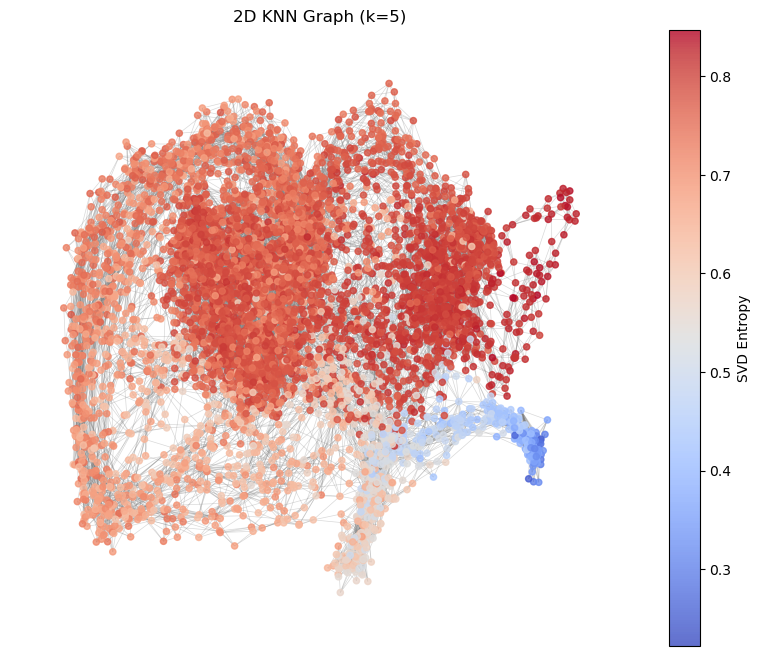

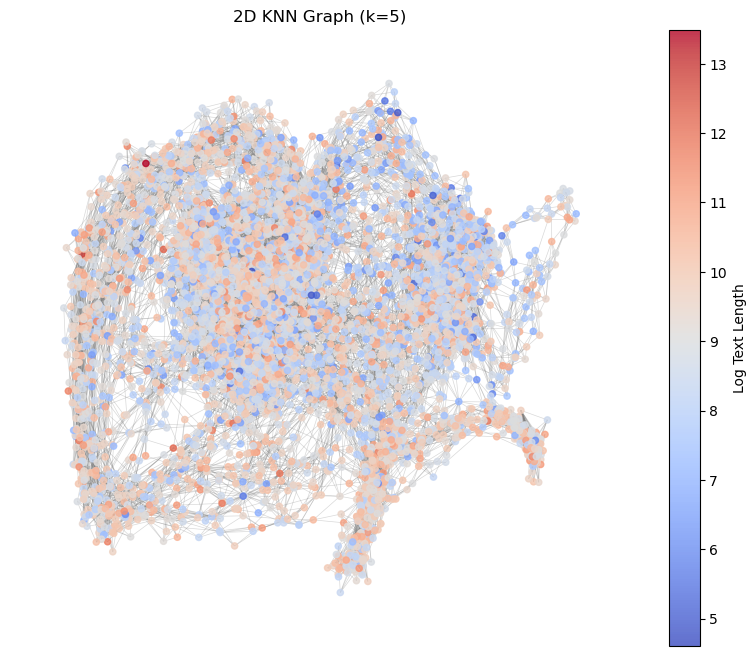

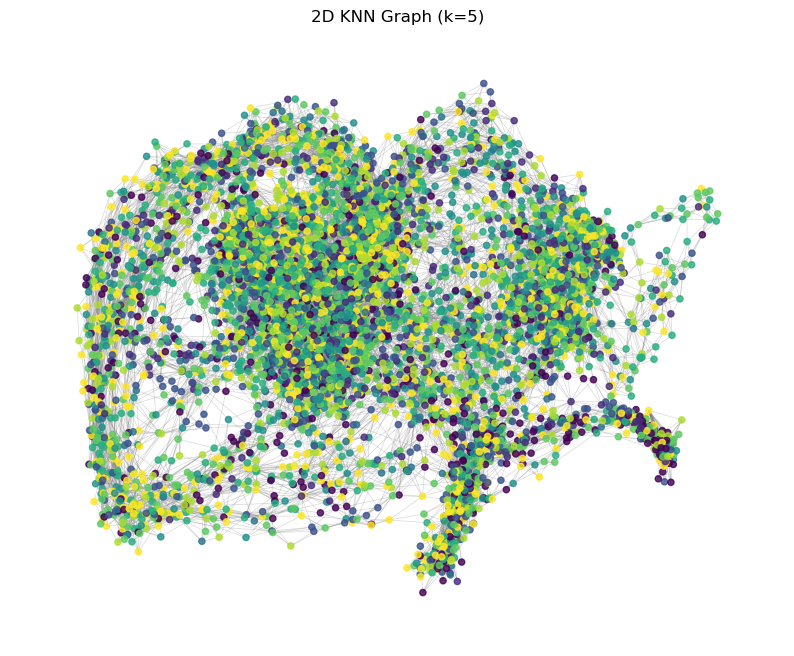

In [ ]:
# Create compact 2D spring layout visualization
pos_2d = nx.spring_layout(G, iterations=50, seed=42)

# Draw edges and nodes
plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=np.log(df_corpus["text"].str.len()), 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='Log Text Length')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["topic"],
                                alpha=0.8)
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

In [ ]:
df_corpus[["text", "svd_entropy"]].sample(50).sort_values(by="svd_entropy")

,text,svd_entropy
5259,# Matrix Algebra\n\nRafael A. Irizarry\nOctobe...,0.415510
734,"Pixel CNN++ (Salimans et al., 2017) models a d...",0.458866
957,Foundation of Variational Autoencoder (VAE)\n\...,0.475587
4220,# Linear predictor function\n\nIn statistics a...,0.511731
1912,# Pattern Recognition and Machine Learning -- ...,0.513925
425,"### Overview\n\nIn autonomous driving, the com...",0.537279
2470,# Vectorization (mathematics)\n\nIn mathematic...,0.548370
973,# Neural networks with PyTorch\n\nDeep learnin...,0.564730
4433,Thank you for visiting nature.com. You are usi...,0.590934
1229,Index: The Book of Statistical ProofsGeneral T...,0.600569


Start point index: 1520, Text: # Introducing matrices

Published:

Here, I will introduce the three main ways of thinking about mat...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 1520 to point 216:
[1520, 5061, 3090, 3267, 977, 2503, 3741, 2420, 2643, 2676, 1453, 2237, 5736, 1423, 3108, 5958, 1760, 509, 2252, 4018, 5134, 709, 3503, 1450, 1980, 3409, 2440, 216]
Path length: 0.0512


,url,text,svd_entropy
1520,https://mbernste.github.io/posts/matrices/,"# Introducing matrices\n\nPublished:\n\nHere, ...",0.486147
5061,http://en.wikipedia.org/wiki/Geometric_distrib...,# Geometric distribution\n\nParameters Support...,0.533424
3090,https://en.wikipedia.org/wiki/Sample_complexity,# Sample complexity\n\nThe sample complexity o...,0.520064
3267,https://senarvi.github.io/reinforce/,# REINFORCE\n\n## Improving sequence-to-sequen...,0.517515
977,http://arogozhnikov.github.io/2016/06/24/gradi...,Gradient boosting (GB) is a machine learning a...,0.554535
2503,https://fairyonice.github.io/Measure-the-uncer...,# Measure the uncertainty in deep learning mod...,0.626923
3741,http://ethen8181.github.io/machine-learning/de...,In [1]:\n# code for loading the format for the...,0.576217
2420,https://zhangtemplar.github.io/normalization/,# An Overview of Normalization Methods in Deep...,0.586434
2643,https://en.wikipedia.org/wiki/Point_process,# Point process\n\nIn statistics and probabili...,0.583295
2676,https://simple.wikipedia.org/wiki/Reinforcemen...,# Reinforcement learning\n\nThe biology behind...,0.647640


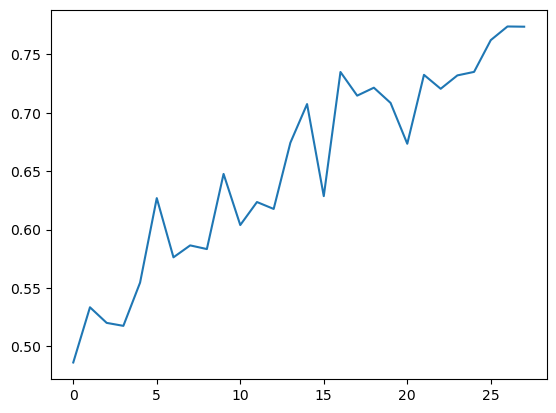

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Introducing matrices"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

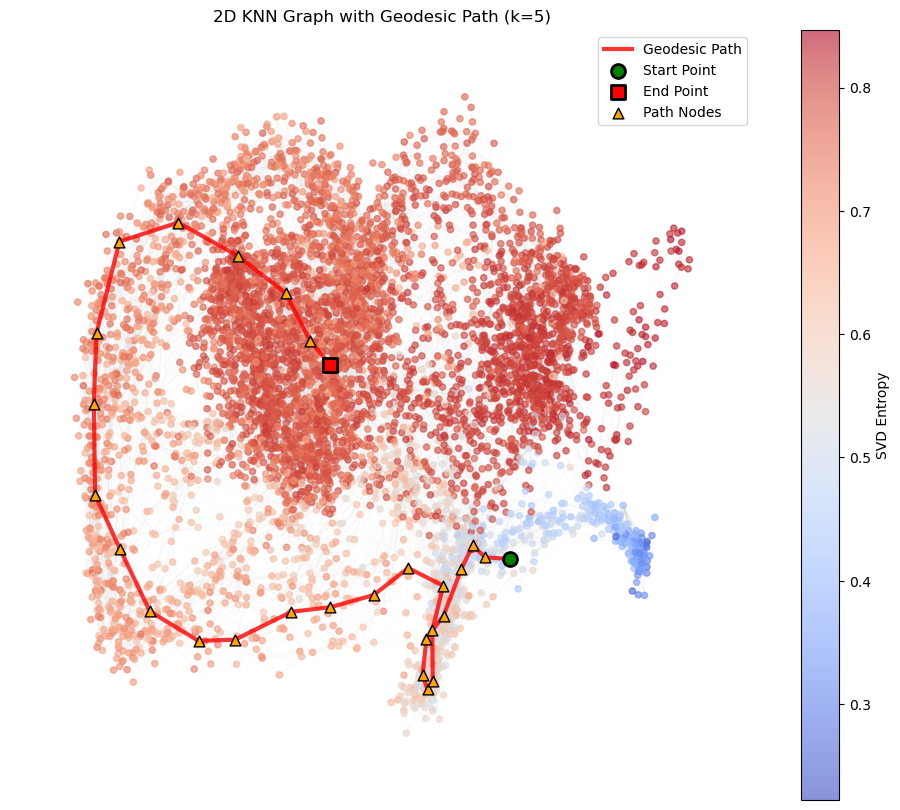

In [ ]:
# Plot the spring layout with the geodesic path highlighted
plt.figure(figsize=(12, 10))

# Draw all edges in light gray
nx.draw_networkx_edges(G, pos_2d, alpha=0.2, width=0.3, edge_color='lightgray')

# Draw all nodes colored by SVD entropy
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.6)

# Highlight the path nodes in larger size
if 'path' in locals():
    path_nodes = [pos_2d[node] for node in path]
    path_x = [pos[0] for pos in path_nodes]
    path_y = [pos[1] for pos in path_nodes]
    
    # Draw path as connected line
    plt.plot(path_x, path_y, 'r-', linewidth=3, alpha=0.8, label='Geodesic Path')
    
    # Highlight start and end points
    plt.scatter([path_x[0]], [path_y[0]], s=100, c='green', marker='o', 
               label='Start Point', edgecolors='black', linewidth=2, zorder=5)
    plt.scatter([path_x[-1]], [path_y[-1]], s=100, c='red', marker='s', 
               label='End Point', edgecolors='black', linewidth=2, zorder=5)
    
    # Highlight intermediate path nodes
    if len(path_x) > 2:
        plt.scatter(path_x[1:-1], path_y[1:-1], s=60, c='orange', marker='^', 
                   label='Path Nodes', edgecolors='black', linewidth=1, zorder=4)

plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph with Geodesic Path (k={k})')
plt.legend()
plt.axis('off')
plt.show()

In [ ]:
# find points lying on the geodesic path, i.e. interpolating on the manifold
# - got to the nearest point that is still closer to the reference point than the current point?

# - build k nearest neighbors graph with small k, large enough to connect
# - find shortest path with A*

# Calculate pairwise diffusion distances using einsum


# Choose a diffusion time t 1, 1.5, 2, 2.5
# higher diffusion time will seperate high entropy points more from low entropy points,
# results in longer paths between points with low and high entropy
t = 1.3
# Compute the diffused Markov matrix for time t
#M_t = eigv_inv[:n_markov_components].T @ np.diag(eigenvalues[:n_markov_components])**t @ eigenvectors[:, :n_markov_components].T

if t % 1 != 0:
    # only raise positive eigenvalues to power t
    #eigv_power = np.diag(np.where(eigenvalues[:n_markov_components] > 0, eigenvalues[:n_markov_components]**t, eigenvalues[:n_markov_components]))
    # Use fractional matrix power for non-integer t
    #eigv_power = np.abs(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
    # use real part of fractional matrix power to avoid complex numbers
    eigv_power = np.real(fractional_matrix_power(np.diag(eigenvalues[:n_markov_components]), t))
else:
    eigv_power = np.diag(eigenvalues[:n_markov_components])**t
M_t = eigv_inv[:n_markov_components].T @ eigv_power @ eigenvectors[:, :n_markov_components].T
M_t = M_t.T
print(M_t.sum(axis=1), M_t.min(), M_t.max())

[1. 1. 1. ... 1. 1. 1.] -0.00037367847304825216 0.005194859125031992


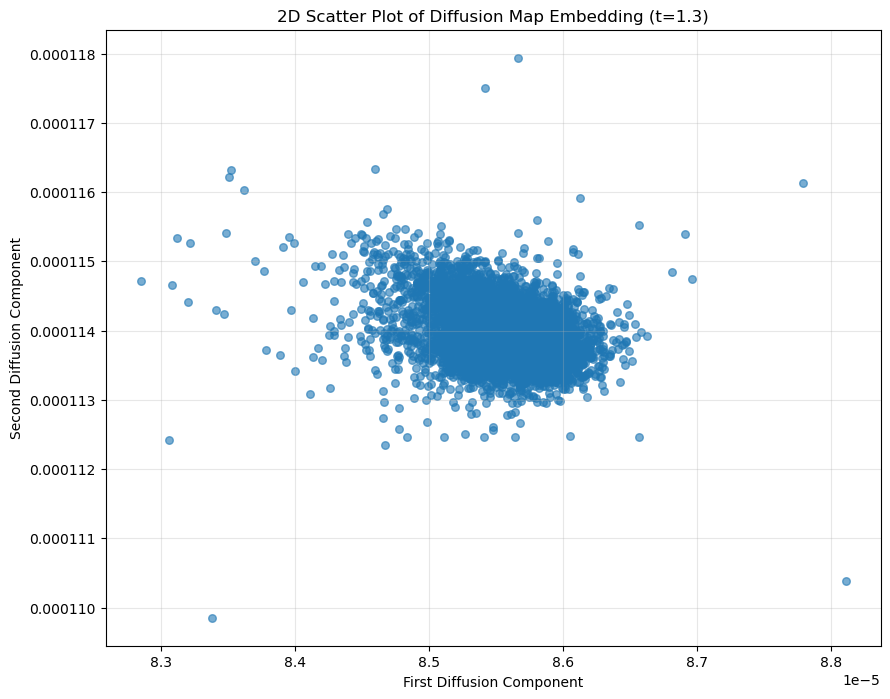

In [ ]:
x, y, z = M_t[:, 1:4][:, 0], M_t[:, 1:4][:, 1], M_t[:, 1:4][:, 2]
plt.figure(figsize=(10, 8))
plt.scatter(x, y, alpha=0.6, s=30)
plt.xlabel('First Diffusion Component')
plt.ylabel('Second Diffusion Component')
plt.title(f'2D Scatter Plot of Diffusion Map Embedding (t={t})')
plt.grid(True, alpha=0.3)
plt.show()

Sample diffusion distance: 0.0040510607346109315


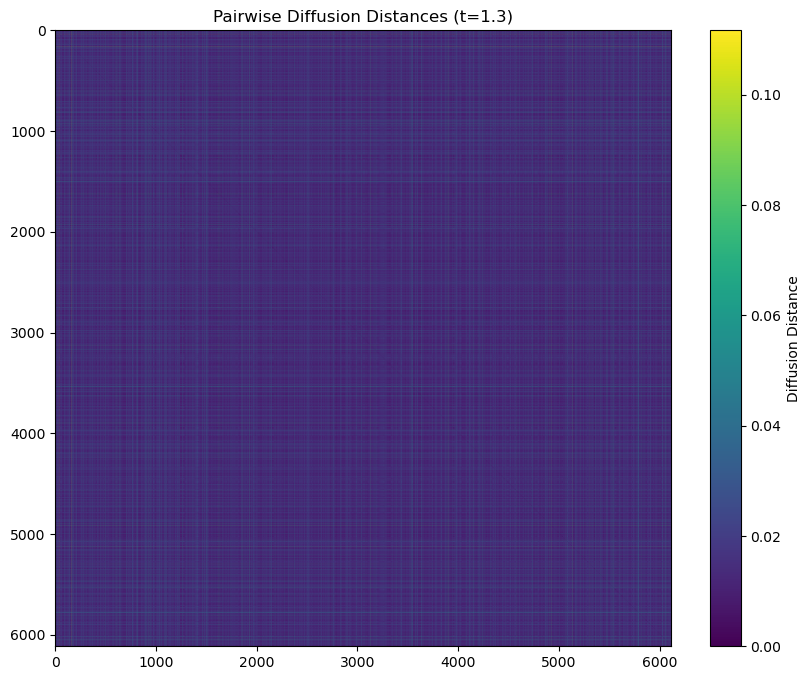

In [ ]:
@njit(parallel=True)
def compute_diffusion_distances(M_t, stationary_distribution):
    n = M_t.shape[0]
    diffusion_distances = np.zeros((n, n))
    for i in prange(n):
        for j in range(i + 1, n):
            diff = M_t[i] - M_t[j]
            distance = np.sum((diff**2) / stationary_distribution)
            diffusion_distances[i, j] = distance
            diffusion_distances[j, i] = distance  # Symmetric matrix
    return diffusion_distances

# Compute pairwise diffusion distances
diffusion_distances = compute_diffusion_distances(M_t, eigenvectors[:, 0]**2)
diffusion_distances = np.sqrt(diffusion_distances)  # Take square root to get distances

# Print a sample diffusion distance
print(f"Sample diffusion distance: {diffusion_distances[0, 1]}")

plt.figure(figsize=(10, 8))
plt.imshow(diffusion_distances, cmap='viridis')
plt.colorbar(label='Diffusion Distance')
plt.title(f'Pairwise Diffusion Distances (t={t})')
plt.show()

In [ ]:
# Create KNN graph
k = 5
n = diffusion_distances.shape[0]
knn_graph = np.zeros((n, n))

# For each point, find its k nearest neighbors
for i in range(n):
    # Get distances from point i to all other points
    distances = diffusion_distances[i]
    # Find indices of k nearest neighbors (excluding itself)
    nearest_indices = np.argsort(distances)[1:k+1]
    # Add edges to KNN graph
    knn_graph[i, nearest_indices] = distances[nearest_indices]
    knn_graph[nearest_indices, i] = distances[nearest_indices]  # Make the graph undirected

# Convert to sparse matrix for efficiency
sparse_knn_graph = csr_matrix(knn_graph)

# Create a NetworkX graph
G = nx.Graph(sparse_knn_graph)

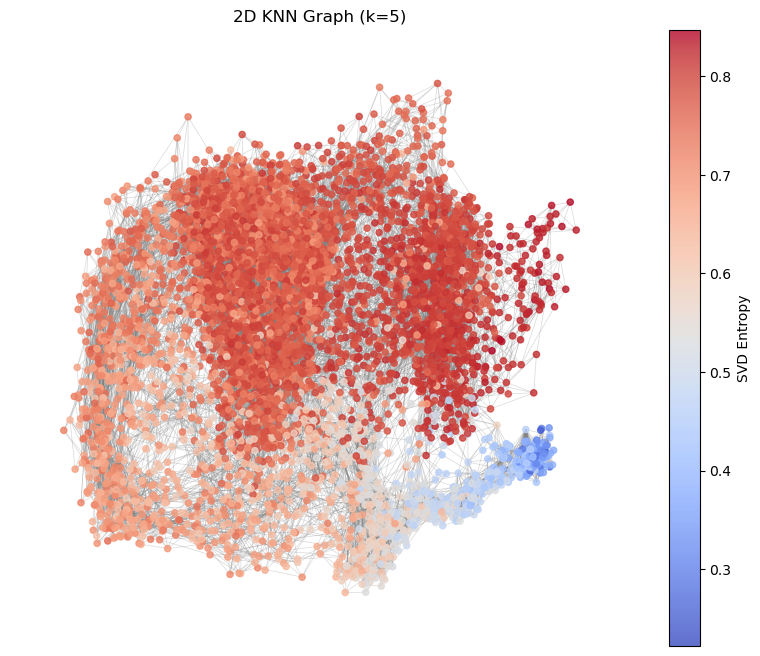

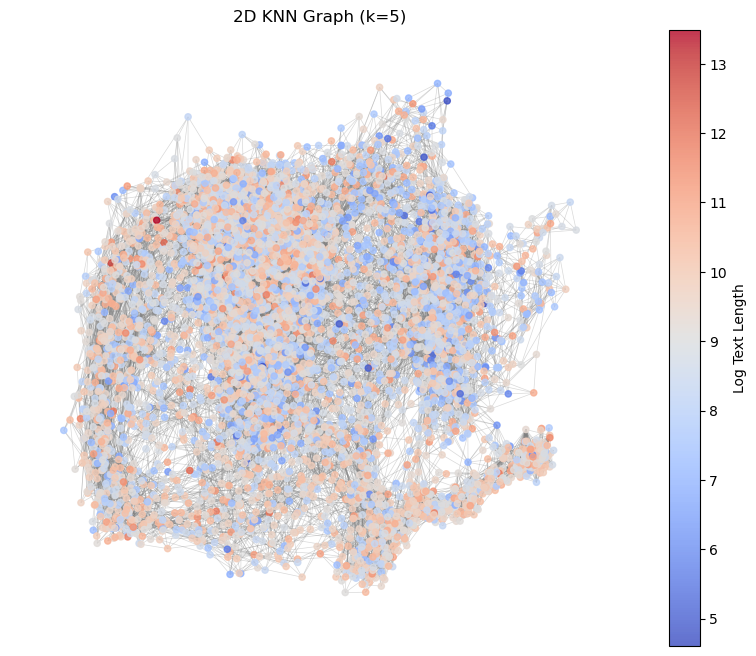

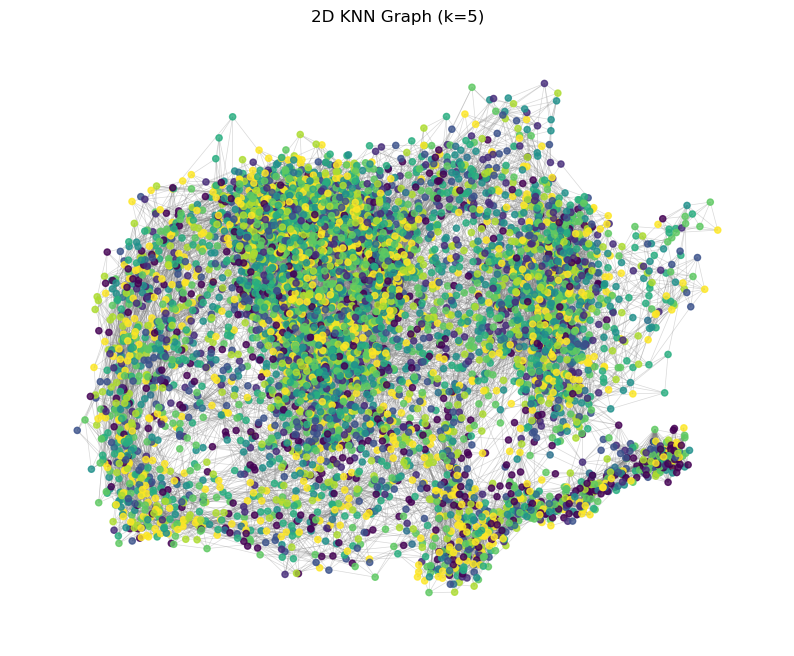

In [ ]:
# Create compact 2D spring layout visualization
pos_2d = nx.spring_layout(G, iterations=50, seed=42)

# Draw edges and nodes
plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=np.log(df_corpus["text"].str.len()), 
                                cmap='coolwarm', alpha=0.8)
plt.colorbar(scatter, label='Log Text Length')
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
nx.draw_networkx_edges(G, pos_2d, alpha=0.3, width=0.5, edge_color='gray')
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["topic"],
                                alpha=0.8)
plt.title(f'2D KNN Graph (k={k})')
plt.axis('off')
plt.show()

In [ ]:
df_corpus[["text", "svd_entropy"]].sample(50).sort_values(by="svd_entropy")

,text,svd_entropy
6038,# Summer School Deep Learning Session 4\n\n## ...,0.437480
5947,Almost surely\n\n(Redirected from Almost never...,0.493526
2355,"In this post, I try and learn as much about Ba...",0.522867
1412,# Sample mean and covariance\n\n(Redirected fr...,0.539745
673,# Online Reinforcement Learning\n\nIn this pos...,0.544813
3674,"# 1.2. Distributions\n\n\nIn this subsection, ...",0.584741
1429,8 Estimating unknown quantities from a sample...,0.585763
1511,"# Kronecker product\n\nIn mathematics, the Kro...",0.590916
1391,# Lecture 25: Spectral Learning for Graphical ...,0.603064
236,### Entropy\n\nA staff misses an all-hands mee...,0.621206


Start point index: 1520, Text: # Introducing matrices

Published:

Here, I will introduce the three main ways of thinking about mat...
End point index: 216, Text: # LSTMs

2 minute read

$\$

# LSTMs to Model Physiological Time Series

Harini Suresh, Nicholas Loc...
Geodesic path from point 1520 to point 216:
[1520, 3570, 3938, 2503, 4520, 3189, 3078, 1371, 4137, 5528, 5793, 5949, 1665, 6028, 1399, 2447, 4507, 6042, 216]
Path length: 0.0822


,url,text,svd_entropy
1520,https://mbernste.github.io/posts/matrices/,"# Introducing matrices\n\nPublished:\n\nHere, ...",0.486147
3570,https://alanarnholt.github.io/BSDA/reference/B...,Data for Exercise 7.40\n\nBacktoback\n\n## For...,0.566419
3938,https://ekbanaml.github.io/generative%20deep%2...,# Autoencoder\n\n## Difference between generat...,0.523292
2503,https://fairyonice.github.io/Measure-the-uncer...,# Measure the uncertainty in deep learning mod...,0.626923
4520,https://jzuern.github.io/blog/2019/autoencoder/,In today’s post I would like to give you a qui...,0.569536
3189,https://csy99.github.io/Blog/2020/07/22/hands-...,"Conv Layers\n\nIn turn, each neuron in the sec...",0.596310
3078,https://libigl.github.io/libigl-python-binding...,# Chapter 2: Matrices and Linear Algebra¶\n\ni...,0.584849
1371,https://danielegrattarola.github.io/posts/2021...,# A practical introduction to GNNs - Part 1\n\...,0.618180
4137,https://mlnotebook.github.io/post/GAN4/,# Generative Adversarial Network (GAN) in Tens...,0.618847
5528,http://nbviewer.jupyter.org/github/JunyoungLim...,# Lecture 6: Further Examples of Classifiers¶\...,0.699216


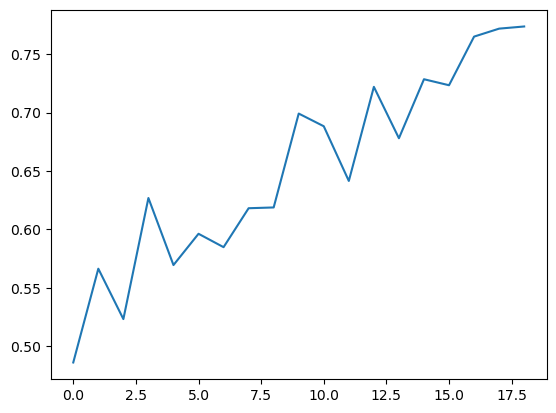

In [ ]:
# Define start and end points (you can change these)
# Find the index of the document containing "Attention Is All You Need"
df_corpus = df_corpus.reset_index(drop=True)
search_term = "Introducing matrices"
#search_term = "Multicollinearity"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
start_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"Start point index: {start_point}, Text: {df_corpus.loc[start_point, 'text'][:100]}...")

search_term = "LSTM"
df_corpus["match_position"] = df_corpus["text"].str.find(search_term)

# Select the document where the match is closest to the beginning of the text
end_point = df_corpus.loc[df_corpus["match_position"] >= 0, "match_position"].idxmin()
print(f"End point index: {end_point}, Text: {df_corpus.loc[end_point, 'text'][:100]}...")

# Find shortest path using Dijkstra's algorithm
try:
    path = nx.dijkstra_path(G, start_point, end_point, weight='weight')
    path_length = nx.dijkstra_path_length(G, start_point, end_point, weight='weight')
    print(f"Geodesic path from point {start_point} to point {end_point}:")
    print(path)
    print(f"Path length: {path_length:.4f}")
except nx.NetworkXNoPath:
    print(f"No path found between {start_point} and {end_point}. Try increasing k.")

df_temp = df_corpus.loc[df_corpus.index[path], ["url", "text", "svd_entropy"]]
df_temp["svd_entropy"].reset_index(drop=True).plot()
df_temp

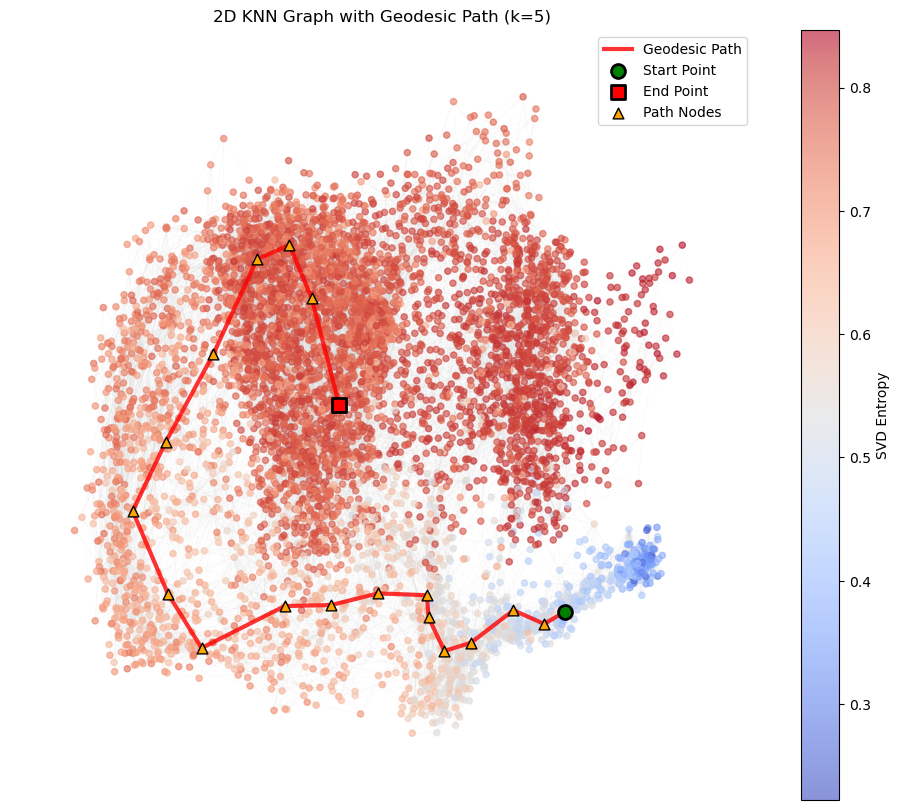

In [ ]:
# Plot the spring layout with the geodesic path highlighted
plt.figure(figsize=(12, 10))

# Draw all edges in light gray
nx.draw_networkx_edges(G, pos_2d, alpha=0.2, width=0.3, edge_color='lightgray')

# Draw all nodes colored by SVD entropy
scatter = nx.draw_networkx_nodes(G, pos_2d, node_size=20, 
                                node_color=df_corpus["svd_entropy"], 
                                cmap='coolwarm', alpha=0.6)

# Highlight the path nodes in larger size
if 'path' in locals():
    path_nodes = [pos_2d[node] for node in path]
    path_x = [pos[0] for pos in path_nodes]
    path_y = [pos[1] for pos in path_nodes]
    
    # Draw path as connected line
    plt.plot(path_x, path_y, 'r-', linewidth=3, alpha=0.8, label='Geodesic Path')
    
    # Highlight start and end points
    plt.scatter([path_x[0]], [path_y[0]], s=100, c='green', marker='o', 
               label='Start Point', edgecolors='black', linewidth=2, zorder=5)
    plt.scatter([path_x[-1]], [path_y[-1]], s=100, c='red', marker='s', 
               label='End Point', edgecolors='black', linewidth=2, zorder=5)
    
    # Highlight intermediate path nodes
    if len(path_x) > 2:
        plt.scatter(path_x[1:-1], path_y[1:-1], s=60, c='orange', marker='^', 
                   label='Path Nodes', edgecolors='black', linewidth=1, zorder=4)

plt.colorbar(scatter, label='SVD Entropy')
plt.title(f'2D KNN Graph with Geodesic Path (k={k})')
plt.legend()
plt.axis('off')
plt.show()

In [ ]:
# Create KNN graph
k = 5
n = diffusion_distances.shape[0]
knn_graph = np.zeros((n, n))

# For each point, find its k nearest neighbors
for i in range(n):
    # Get distances from point i to all other points
    distances = diffusion_distances[i]
    # Find indices of k nearest neighbors (excluding itself)
    nearest_indices = np.argsort(distances)[1:k+1]
    # Add edges to KNN graph
    knn_graph[i, nearest_indices] = distances[nearest_indices]
    knn_graph[nearest_indices, i] = distances[nearest_indices]  # Make the graph undirected

# Convert to sparse matrix for efficiency
sparse_knn_graph = csr_matrix(knn_graph)

# Create a NetworkX graph
G = nx.Graph(sparse_knn_graph)